In [1]:
import urllib.request
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt


In [2]:
url = 'https://www.csee.umbc.edu/courses/graduate/678/spring23/materials/a4-data/2d-kmeans-input.ssv'
file_path = '2d-kmeans-input.ssv'
urllib.request.urlretrieve(url, file_path)

('2d-kmeans-input.ssv', <http.client.HTTPMessage at 0x7f8539923b20>)

In [54]:
data = pd.read_csv(file_path, delim_whitespace=True, header=None)


In [4]:
print(data)

         0       1
0   0.3637  0.4601
1   0.4708  0.4964
2   0.3526  0.4903
3   0.4456  0.4139
4   0.4460  0.4516
..     ...     ...
95  0.6536  0.4635
96  0.7605  0.4923
97  0.6242  0.4693
98  0.6374  0.4823
99  0.6939  0.4389

[100 rows x 2 columns]


In [55]:
import numpy as np

def kmeans_cluster(data, num_clusters, Convergence_steps=100):

    # Initializing cluster points as initial cluster centers randomly
    cluster_mean = data[np.random.randint(0, len(data), size=num_clusters)]
    
    
    for i in range(Convergence_steps):
        # Assigning points to the respective cluster mean
        print("Iter:",i+1)
        labels_class = find_cluster_points(data, cluster_mean)

        variance = np.var(data)

        print(f'Iteration {i+1}: Variance = {variance}')

        cluster_plot(data, labels_class, cluster_mean, i)

        # Update cluster mean
        new_cluster_mean = cluster_new_mean(data, labels_class, num_clusters)

        
        

        # Check for convergence i.e if the calculation of centroids are same as before then we stop
        if np.array_equal(cluster_mean, new_cluster_mean):
          break

        cluster_mean = new_cluster_mean
        #
        


    return cluster_mean, labels_class


def find_cluster_points(data, cluster_mean):
    label_class = []
    for point in data:

        # Recalculating new cluster mean

        diff = cluster_mean-point
        squared_distance = np.sum(diff**2, axis=1)
        Euclidean_distance = np.sqrt(squared_distance)
        #print(Euclidean_distance,"dist:")

        # Assigning the point to the nearest cluster center
        index = np.argmin(Euclidean_distance)
        #print(label,"label:")
        label_class.append(index)

    return np.array(label_class)#typecasting it because data read is from pandas and need to convert it to numpy

def cluster_plot(data, labels_class, cluster_mean, iter):
    plt.scatter(data[:, 0], data[:, 1], c=labels_class)
    plt.scatter(cluster_mean[:, 0], cluster_mean[:, 1], c='red', marker='x')
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.title(f'K-means Clustering Iteration {iter+1}')
    plt.show()

def cluster_new_mean(data, labels_class, num_clusters):
    new_cluster_centers = []
    for i in range(num_clusters):

      #filtering individual label data
        cluster_each = data[labels_class == i]

        # Update cluster centers as the mean of the cluster points
        cluster_center = np.mean(cluster_each, axis=0)
        new_cluster_centers.append(cluster_center)

    return np.array(new_cluster_centers)


'''
plt.scatter(data[0], data[1], c=labels)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('K-means Clustering')
plt.show()
'''

"\nplt.scatter(data[0], data[1], c=labels)\nplt.xlabel('X')\nplt.ylabel('Y')\nplt.title('K-means Clustering')\nplt.show()\n"

Iter: 1
Iteration 1: Variance = 0.00902850418775


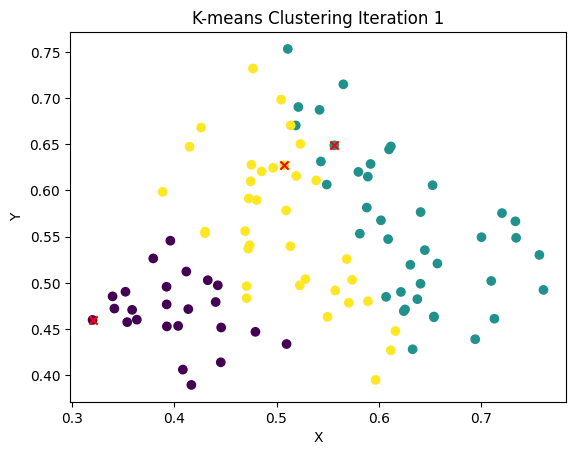

Iter: 2
Iteration 2: Variance = 0.00902850418775


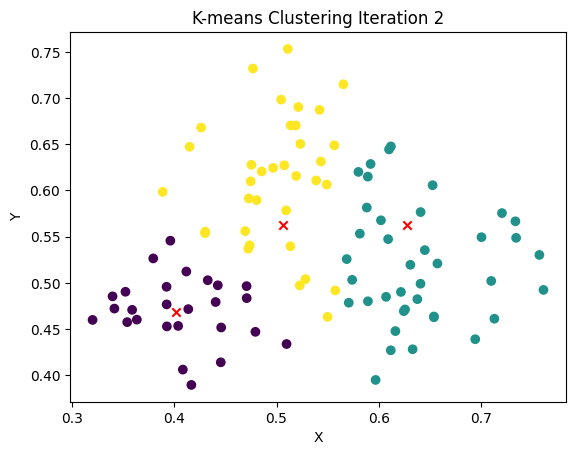

Iter: 3
Iteration 3: Variance = 0.00902850418775


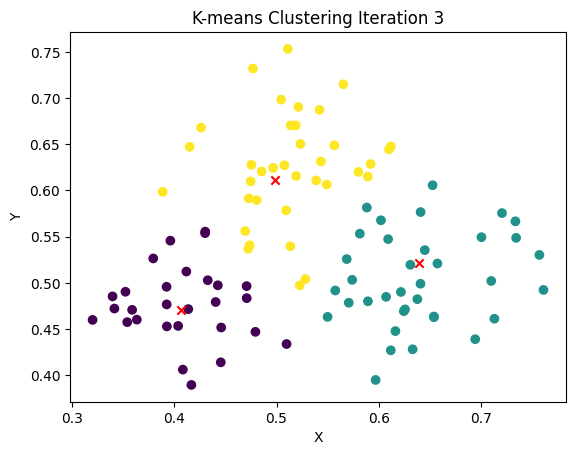

Iter: 4
Iteration 4: Variance = 0.00902850418775


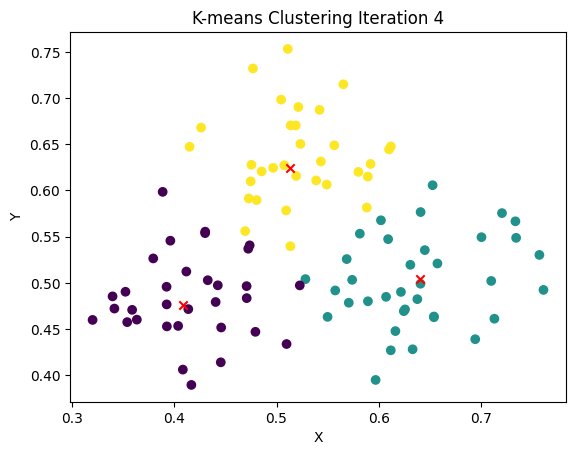

Iter: 5
Iteration 5: Variance = 0.00902850418775


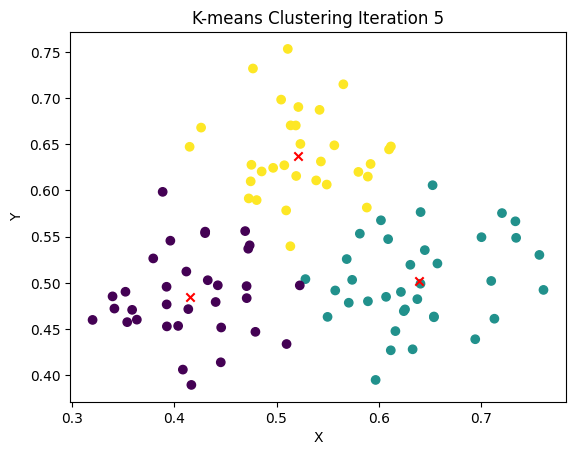

Iter: 6
Iteration 6: Variance = 0.00902850418775


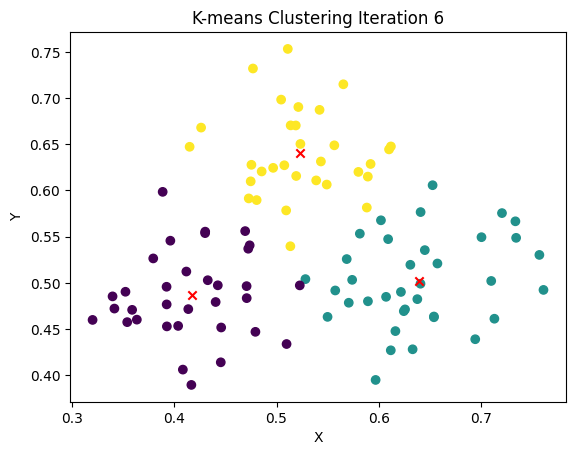

[[0.4172303  0.48693333]
 [0.63873611 0.50159444]
 [0.52296452 0.6401    ]] [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 2 1 2 2
 1 2 2 2 1 2 2 2 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 1 1 1 1 2 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1]


In [56]:
num_clusters = 3  # Number of clusters
data_numpy=data.values

cen, labels = kmeans_cluster(data_numpy, num_clusters)
print(cen,labels)

Iter: 1
Iteration 1: Variance = 0.00902850418775


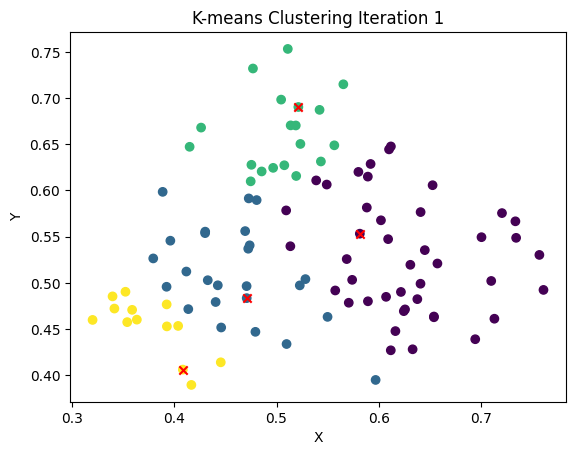

Iter: 2
Iteration 2: Variance = 0.00902850418775


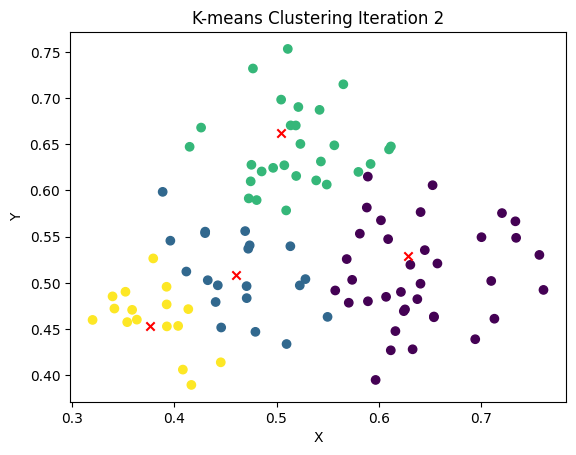

Iter: 3
Iteration 3: Variance = 0.00902850418775


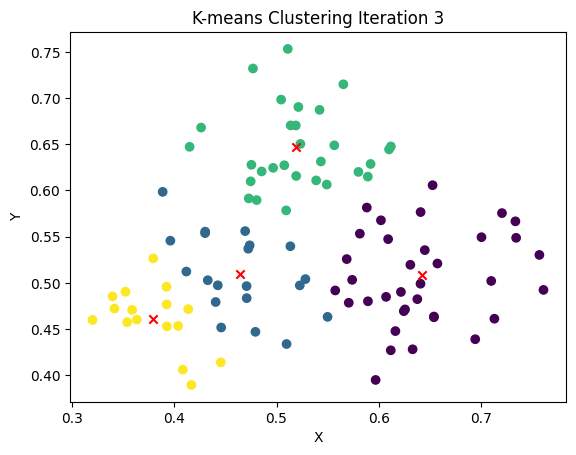

Iter: 4
Iteration 4: Variance = 0.00902850418775


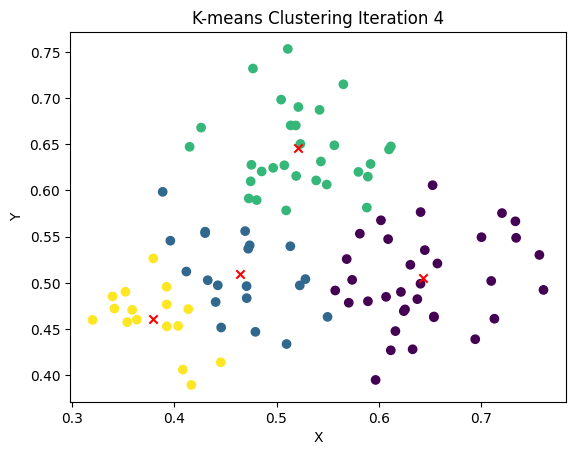

Iter: 5
Iteration 5: Variance = 0.00902850418775


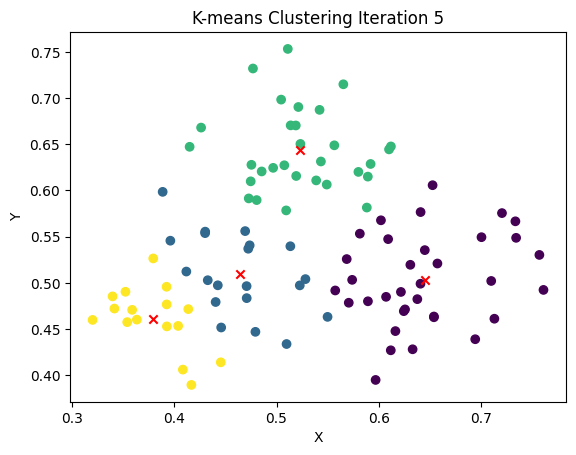

[[0.64460294 0.50265588]
 [0.464045   0.50971   ]
 [0.52328    0.64345   ]
 [0.37995    0.46133125]] [3 1 3 3 1 3 3 3 3 3 3 1 3 1 1 1 1 3 3 3 3 1 1 1 1 1 1 3 3 1 1 1 2 2 0 2 2
 0 2 2 2 0 2 2 2 2 2 2 1 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 2 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


"\nplt.scatter(data[0], data[1], c=labels)\nplt.xlabel('X')\nplt.ylabel('Y')\nplt.title('K-means Clustering Results')\nplt.show()\n"

In [35]:
num_clusters = 4  # Number of clusters
data_numpy=data.values

cen, labels = kmeans_cluster(data_numpy, num_clusters)
print(cen,labels)
'''
plt.scatter(data[0], data[1], c=labels)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('K-means Clustering Results')
plt.show()
'''

Iter: 1
Iteration 1: Variance = 0.00902850418775


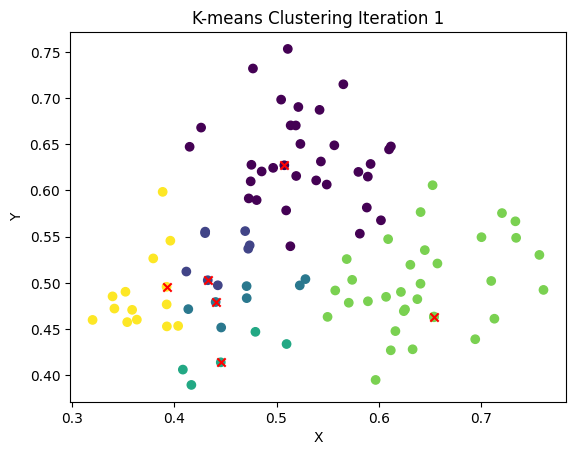

Iter: 2
Iteration 2: Variance = 0.00902850418775


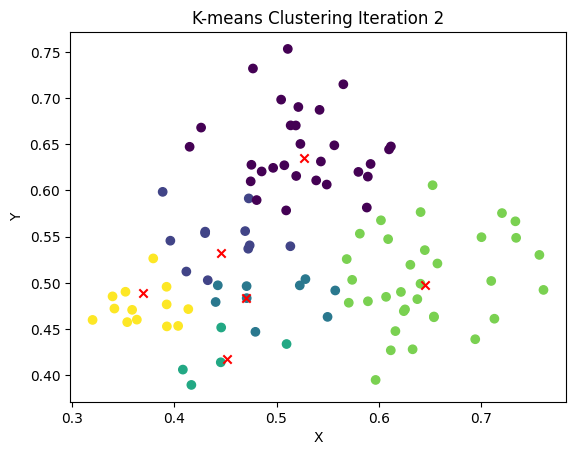

Iter: 3
Iteration 3: Variance = 0.00902850418775


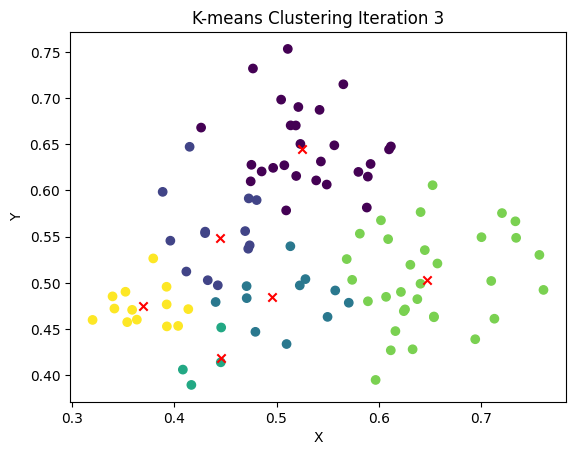

Iter: 4
Iteration 4: Variance = 0.00902850418775


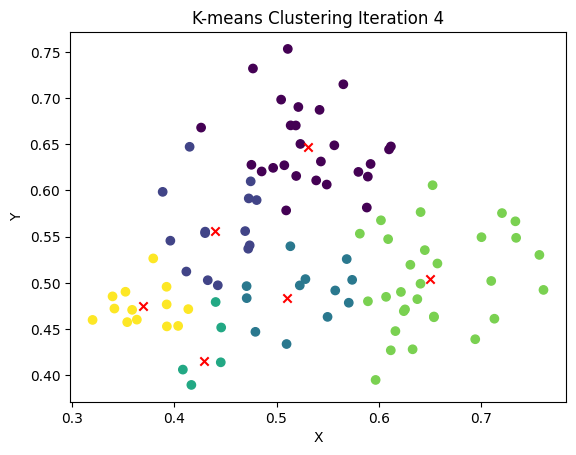

Iter: 5
Iteration 5: Variance = 0.00902850418775


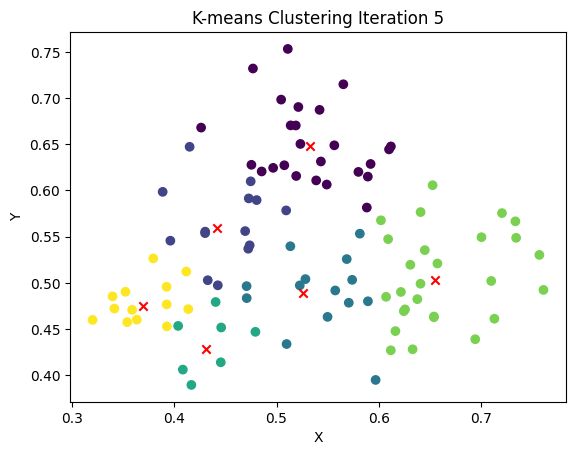

Iter: 6
Iteration 6: Variance = 0.00902850418775


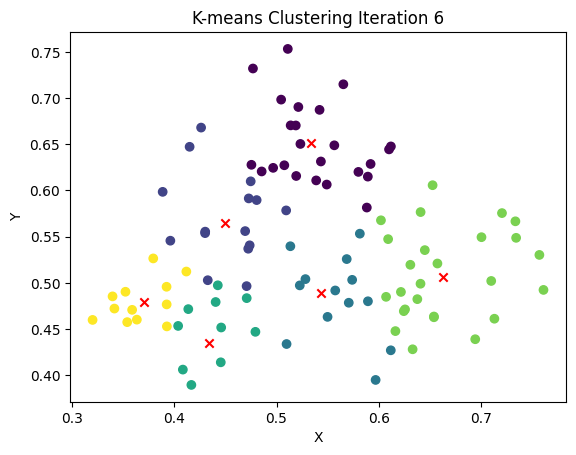

Iter: 7
Iteration 7: Variance = 0.00902850418775


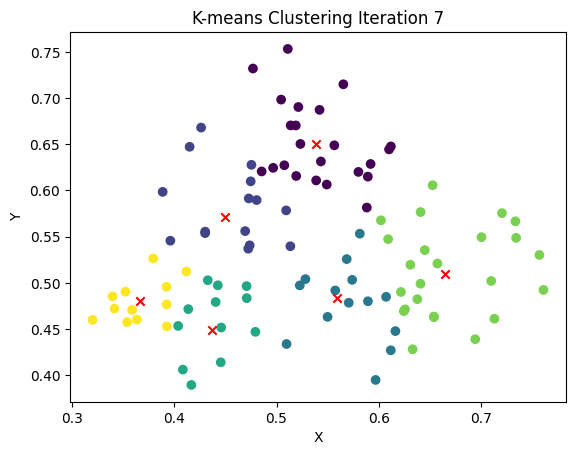

Iter: 8
Iteration 8: Variance = 0.00902850418775


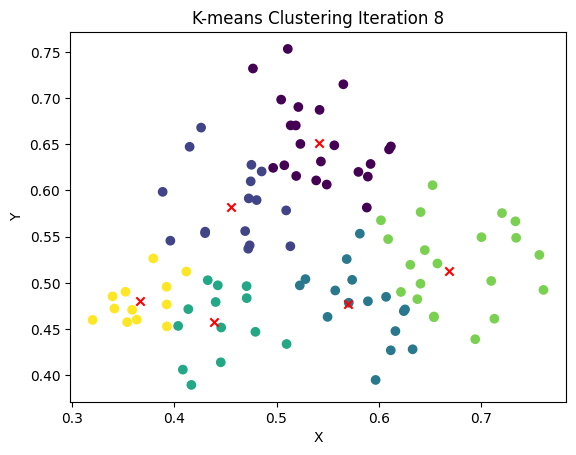

Iter: 9
Iteration 9: Variance = 0.00902850418775


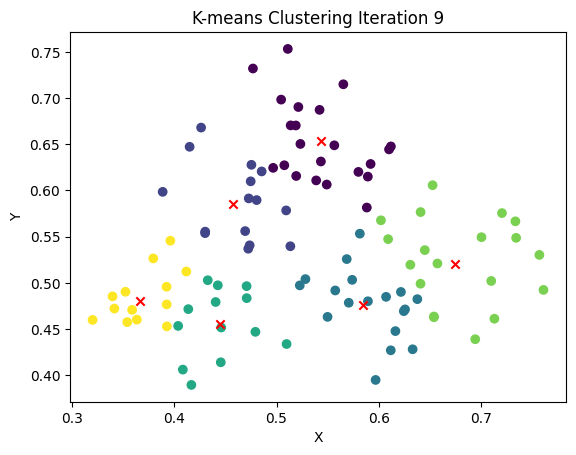

Iter: 10
Iteration 10: Variance = 0.00902850418775


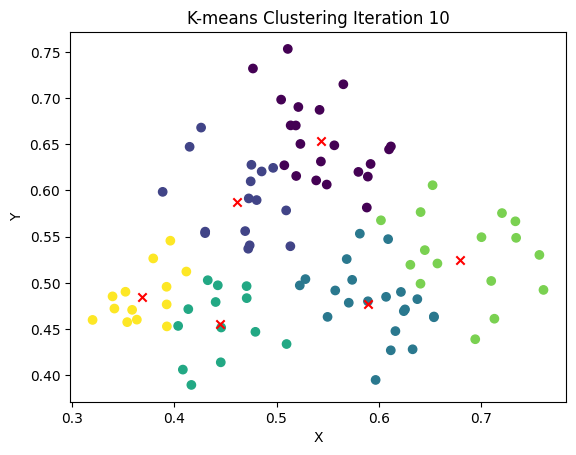

Iter: 11
Iteration 11: Variance = 0.00902850418775


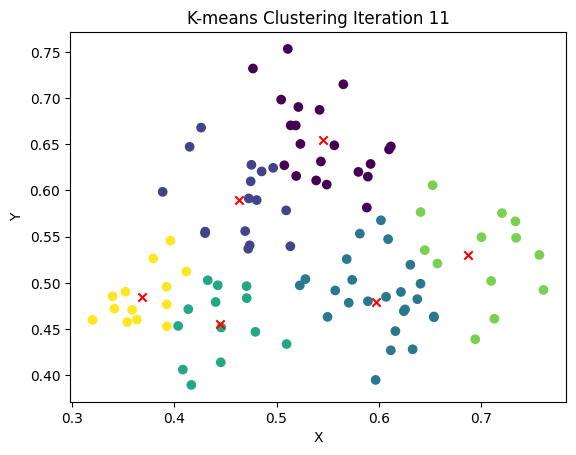

Iter: 12
Iteration 12: Variance = 0.00902850418775


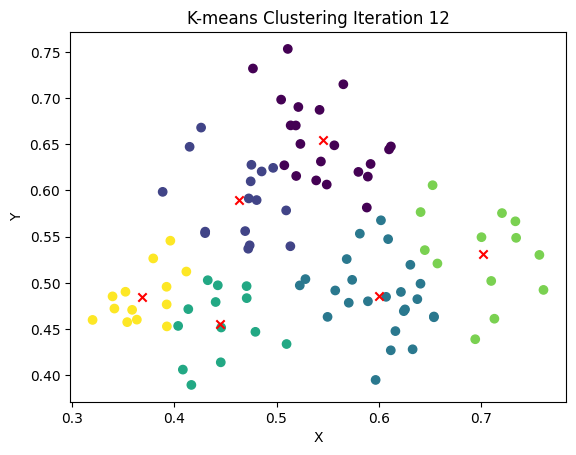

[[0.54578095 0.65456667]
 [0.46348125 0.5899    ]
 [0.6001125  0.48547083]
 [0.44477692 0.4558    ]
 [0.70111538 0.53102308]
 [0.36912308 0.485     ]] [5 3 5 3 3 3 5 5 5 3 3 3 5 1 3 1 1 3 5 5 5 3 3 3 1 3 1 5 5 5 5 1 1 0 2 0 0
 2 0 1 1 4 0 1 0 0 1 0 2 0 1 1 1 0 0 0 1 0 0 0 0 0 0 0 0 1 4 2 4 4 2 0 2 2
 4 2 4 2 4 2 4 4 2 2 2 2 2 2 2 4 2 4 2 2 2 2 4 2 2 4]


In [37]:
num_clusters = 6  # Number of clusters
data_numpy=data.values

cen, labels = kmeans_cluster(data_numpy, num_clusters)
print(cen,labels)

Iter: 1
Iteration 1: Variance = 0.00902850418775


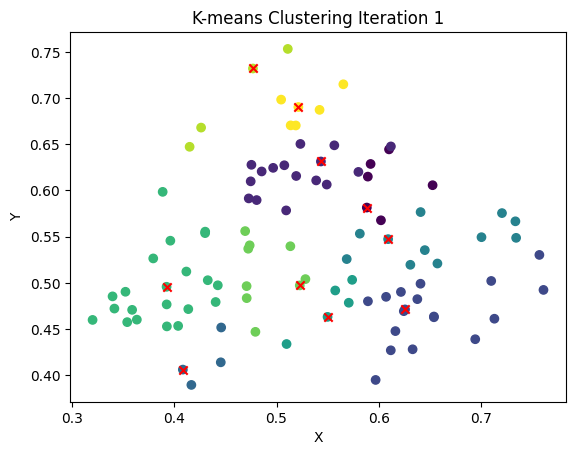

Iter: 2
Iteration 2: Variance = 0.00902850418775


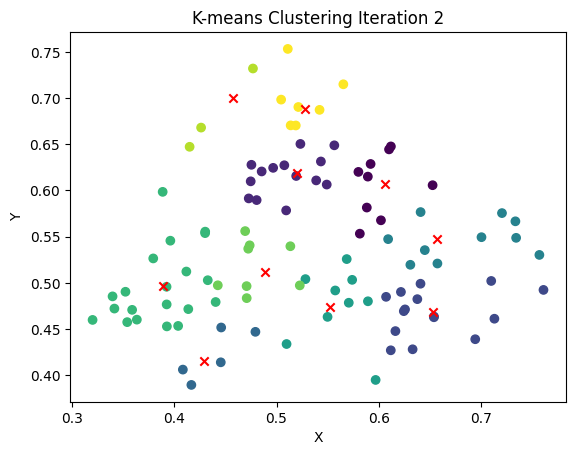

Iter: 3
Iteration 3: Variance = 0.00902850418775


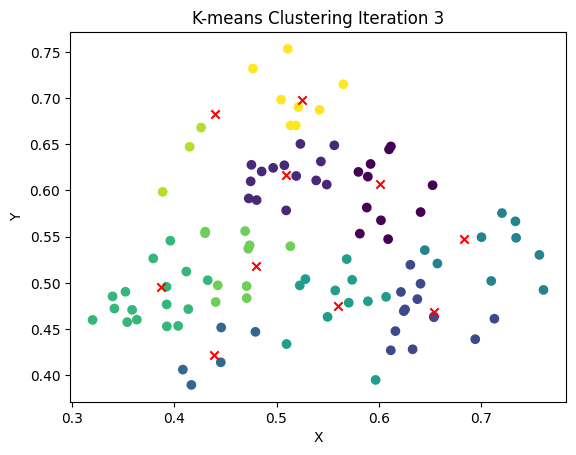

Iter: 4
Iteration 4: Variance = 0.00902850418775


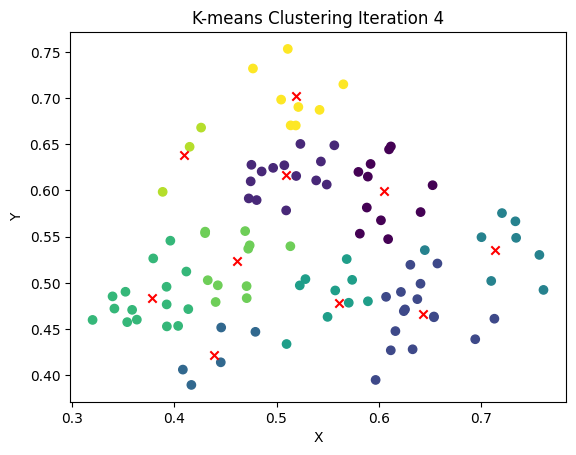

Iter: 5
Iteration 5: Variance = 0.00902850418775


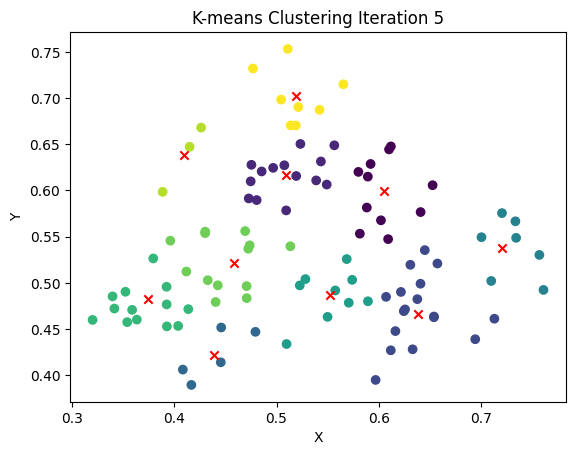

Iter: 6
Iteration 6: Variance = 0.00902850418775


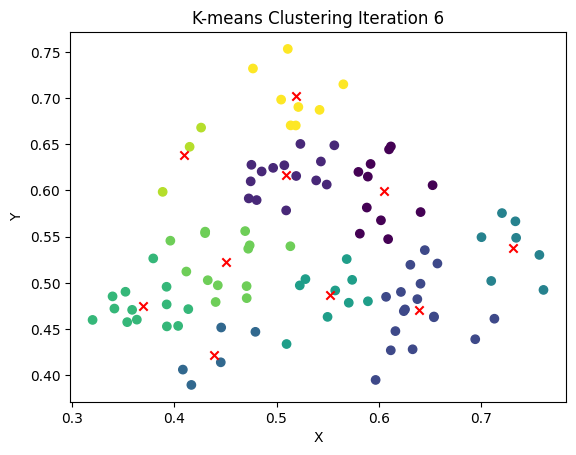

[[0.60502727 0.59890909]
 [0.50949286 0.61665714]
 [0.63875294 0.47035882]
 [0.4393     0.42156   ]
 [0.73048571 0.53781429]
 [0.5522     0.48633333]
 [0.36985385 0.47476923]
 [0.45046923 0.52301538]
 [0.41016667 0.63796667]
 [0.5192     0.702175  ]] [6 7 6 3 3 6 6 6 6 3 3 5 6 7 7 8 7 6 6 6 6 7 7 3 7 7 7 6 6 7 7 7 1 1 0 9 1
 5 9 1 8 0 0 1 1 9 8 1 5 1 1 1 7 1 0 1 1 0 9 9 9 9 9 0 0 1 2 2 4 4 2 0 5 2
 2 2 4 0 4 2 2 4 0 2 5 2 2 2 5 4 5 0 2 5 5 2 4 2 2 2]


In [42]:
num_clusters = 10  # Number of clusters
data_numpy=data.values

cen, labels = kmeans_cluster(data_numpy, num_clusters)
print(cen,labels)

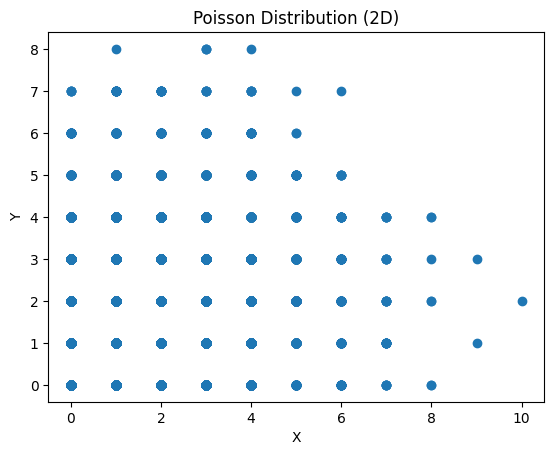

Iter: 1
Iteration 1: Variance = 2.0028989999999998


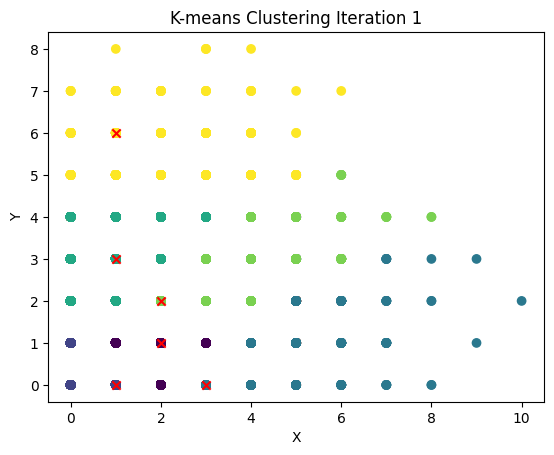

Iter: 2
Iteration 2: Variance = 2.0028989999999998


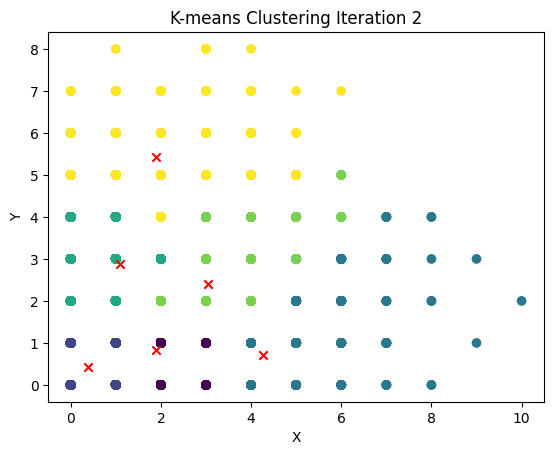

Iter: 3
Iteration 3: Variance = 2.0028989999999998


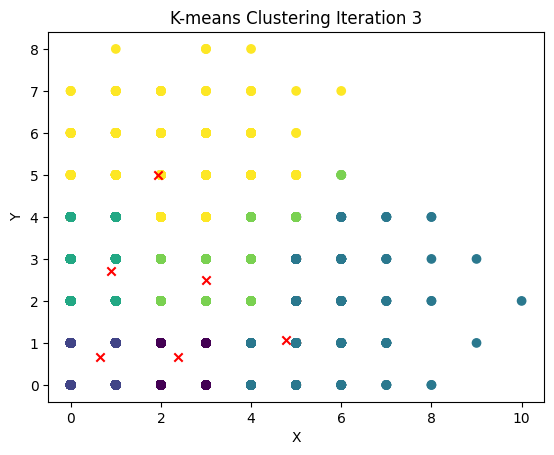

Iter: 4
Iteration 4: Variance = 2.0028989999999998


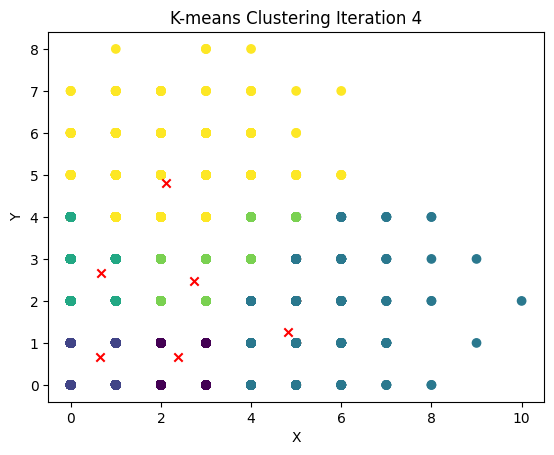

Iter: 5
Iteration 5: Variance = 2.0028989999999998


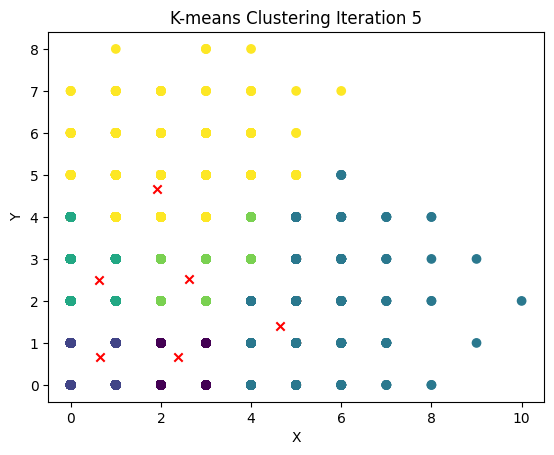

Iter: 6
Iteration 6: Variance = 2.0028989999999998


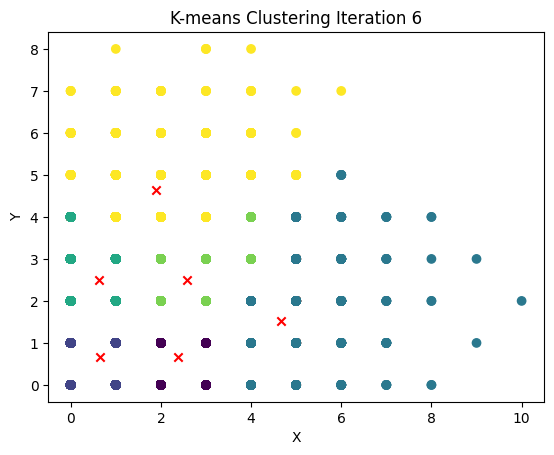

[[2.3860314  0.6551164 ]
 [0.65276914 0.66583696]
 [4.65998177 1.51868733]
 [0.62212212 2.503003  ]
 [2.57405784 2.49824715]
 [1.88879384 4.65269461]] [4 0 1 ... 5 5 4]


In [53]:

import numpy as np
import matplotlib.pyplot as plt

lambda_ = 2  # Parameter lambda for the Poisson distribution
size = 10000  # data size

# Generating 2-D Poisson data
data_pd = np.column_stack((np.random.poisson(lambda_, size), np.random.poisson(lambda_, size)))


plt.scatter(data_pd[:, 0], data_pd[:, 1])
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Poisson Distribution (2D)')
plt.show()



num_clusters = 6  # Number of clusters
data_numpy=data_pd

cen, labels = kmeans_cluster(data_numpy, num_clusters)
print(cen,labels)


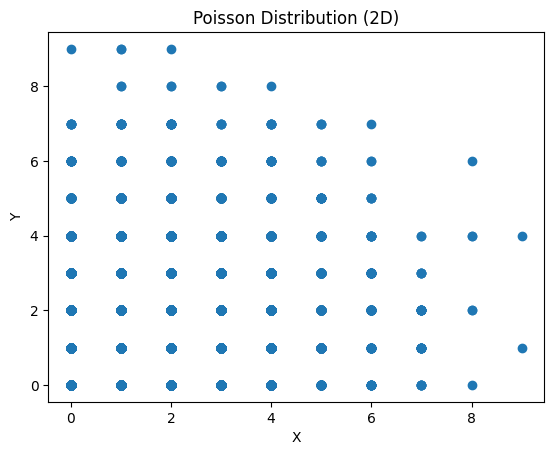

Iter: 1
Iteration 1: Variance = 2.0290884399999998


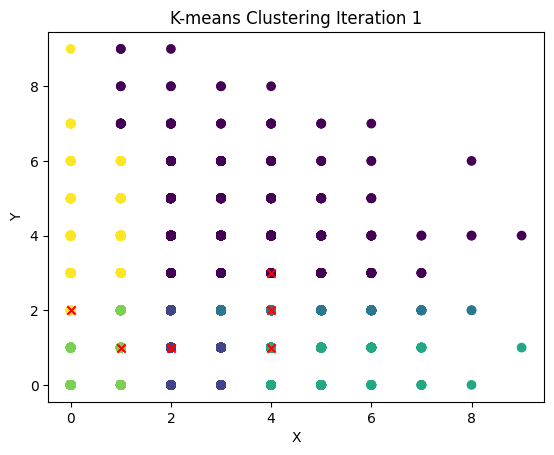

Iter: 2
Iteration 2: Variance = 2.0290884399999998


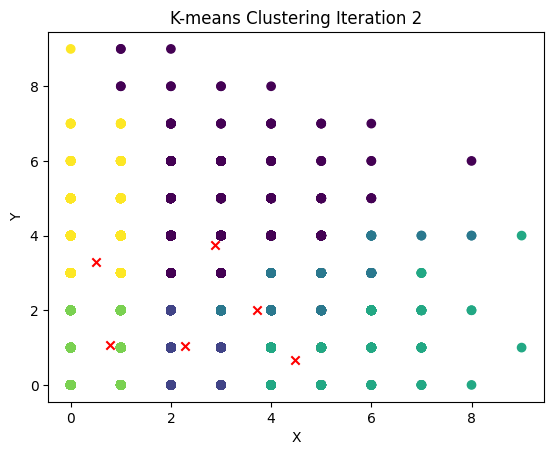

Iter: 3
Iteration 3: Variance = 2.0290884399999998


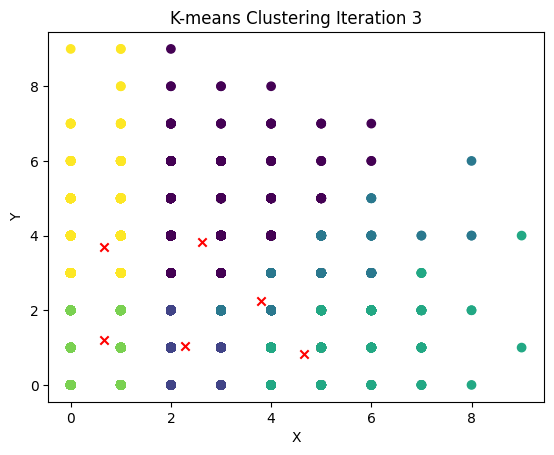

Iter: 4
Iteration 4: Variance = 2.0290884399999998


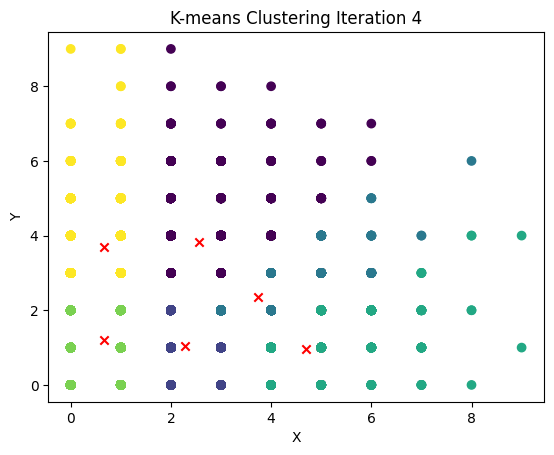

Iter: 5
Iteration 5: Variance = 2.0290884399999998


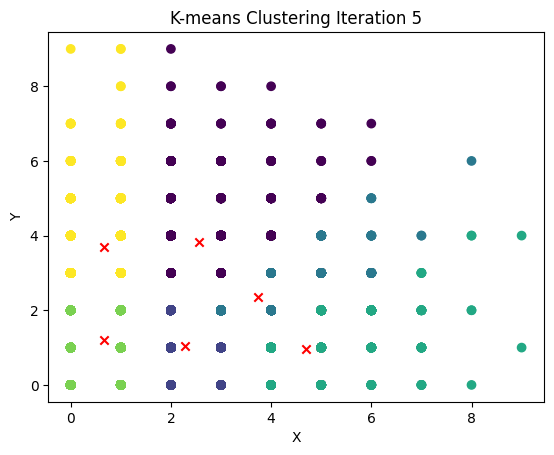

[[2.5562954  3.81658596]
 [2.28804982 1.04281822]
 [3.73598369 2.35372069]
 [4.70485175 0.95822102]
 [0.67174465 1.19078709]
 [0.65973826 3.70669746]] [0 5 1 ... 1 1 4]


In [45]:
import numpy as np
import matplotlib.pyplot as plt

lambda_ = 2  # Parameter lambda for the Poisson distribution
size = 10000  # data size

# Generating 2-D Poisson data
data = np.column_stack((np.random.poisson(lambda_, size), np.random.poisson(lambda_, size)))


plt.scatter(data[:, 0], data[:, 1])
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Poisson Distribution (2D)')
plt.show()



num_clusters = 6  # Number of clusters
data_numpy=data

cen, labels = kmeans_cluster(data_numpy, num_clusters)
print(cen,labels)

[[ 0.41849367  0.70911005]
 [-0.13533544  0.16895184]
 [ 2.6697755   0.29226089]
 ...
 [ 0.81605711 -0.62233142]
 [ 0.63076239  0.2999755 ]
 [-0.56694334 -0.15174829]]
Iter: 1
Iteration 1: Variance = 0.9917171811570992


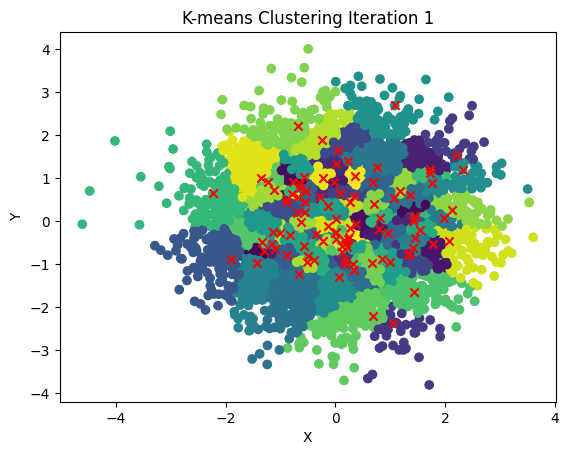

Iter: 2
Iteration 2: Variance = 0.9917171811570992


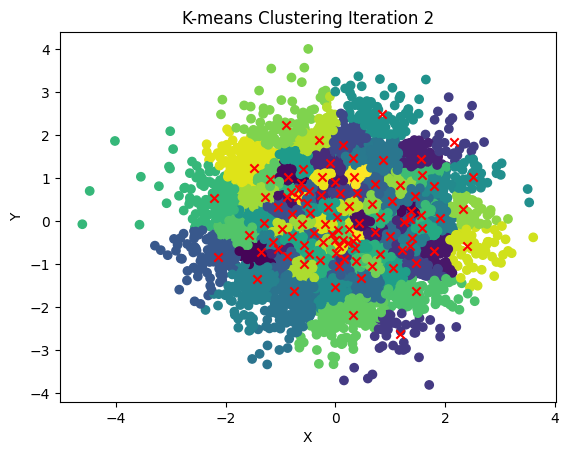

Iter: 3
Iteration 3: Variance = 0.9917171811570992


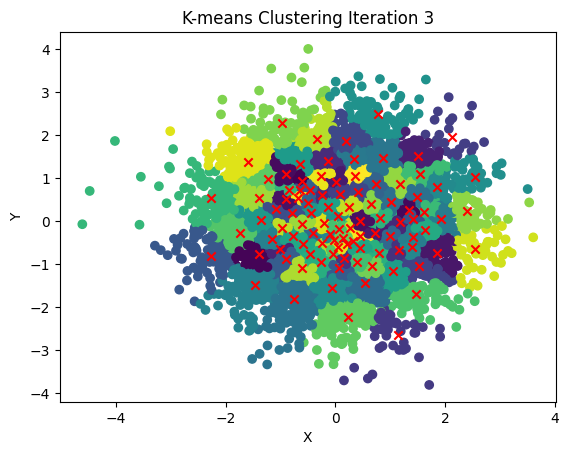

Iter: 4
Iteration 4: Variance = 0.9917171811570992


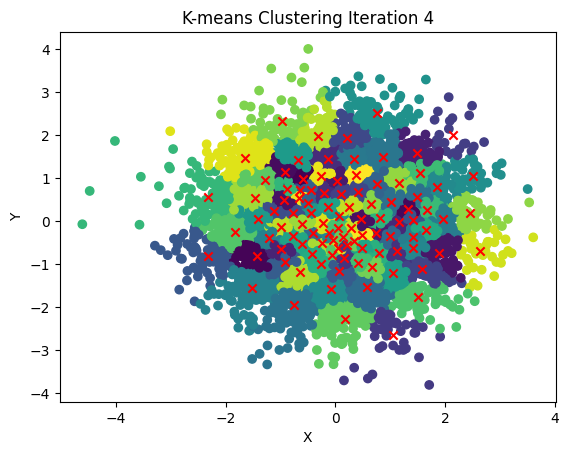

Iter: 5
Iteration 5: Variance = 0.9917171811570992


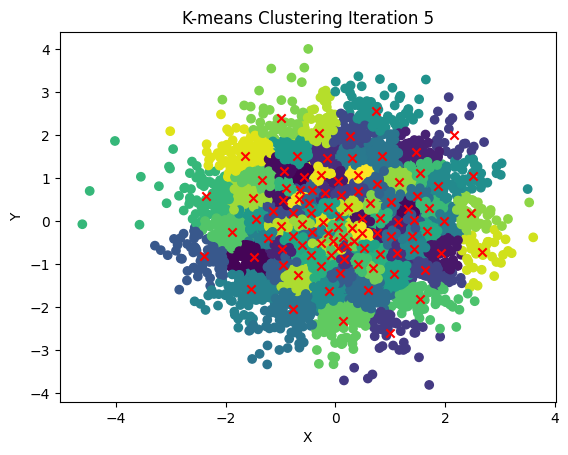

Iter: 6
Iteration 6: Variance = 0.9917171811570992


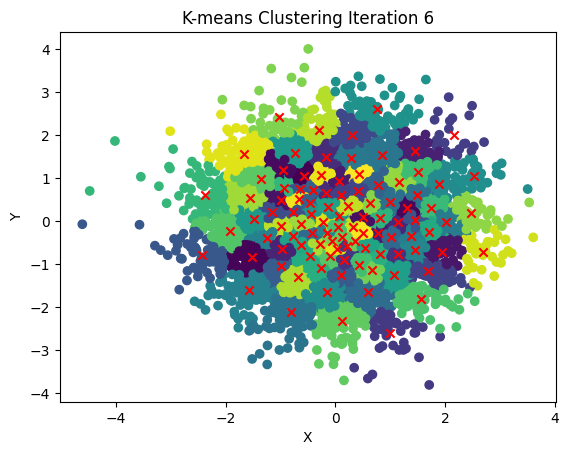

Iter: 7
Iteration 7: Variance = 0.9917171811570992


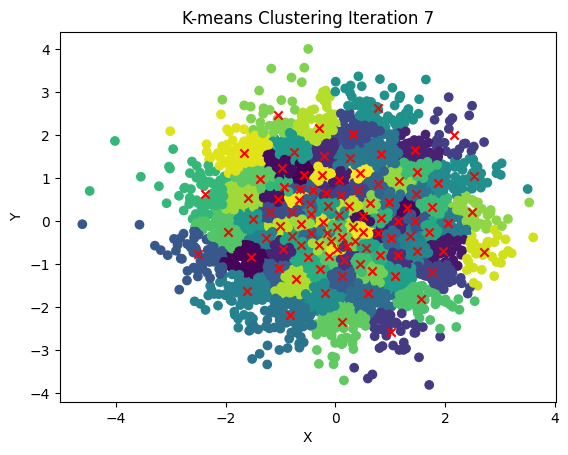

Iter: 8
Iteration 8: Variance = 0.9917171811570992


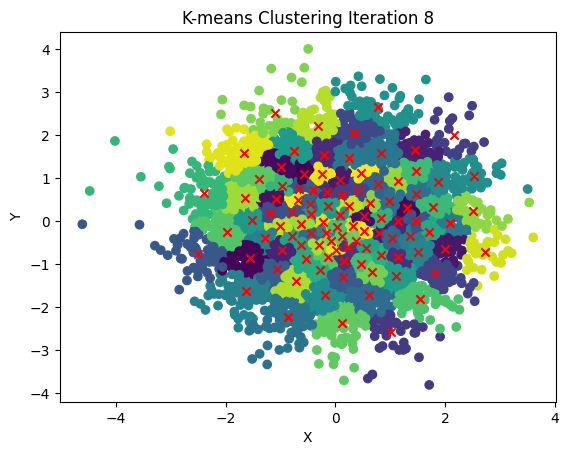

Iter: 9
Iteration 9: Variance = 0.9917171811570992


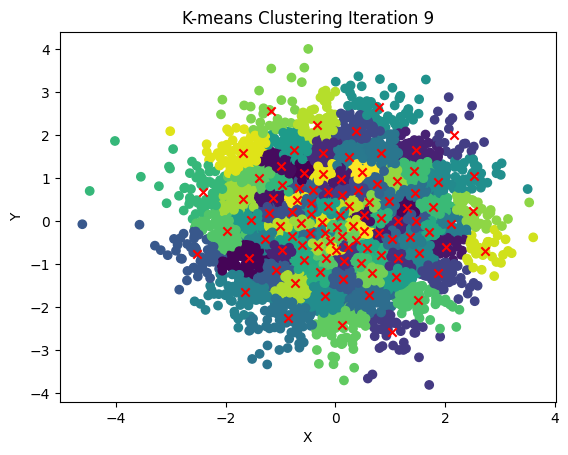

Iter: 10
Iteration 10: Variance = 0.9917171811570992


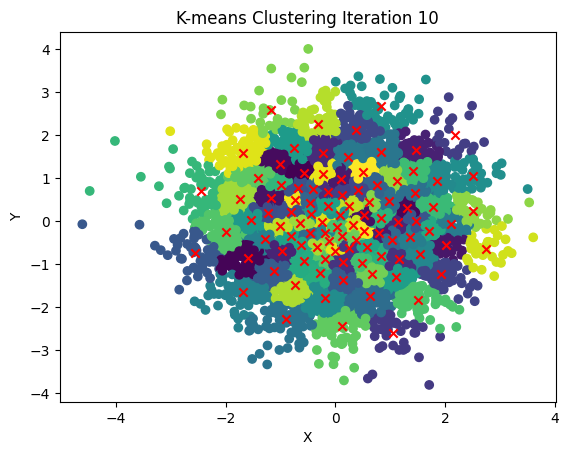

Iter: 11
Iteration 11: Variance = 0.9917171811570992


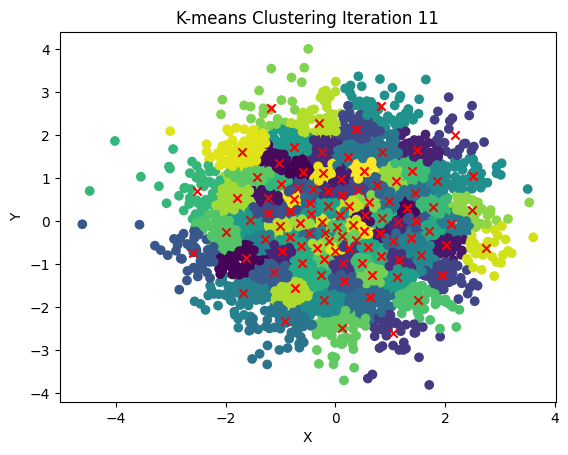

Iter: 12
Iteration 12: Variance = 0.9917171811570992


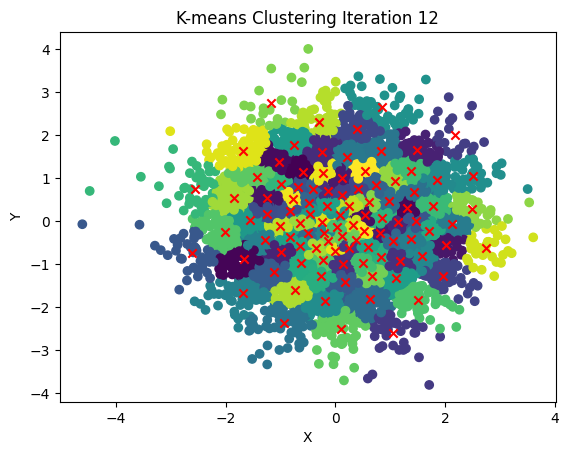

Iter: 13
Iteration 13: Variance = 0.9917171811570992


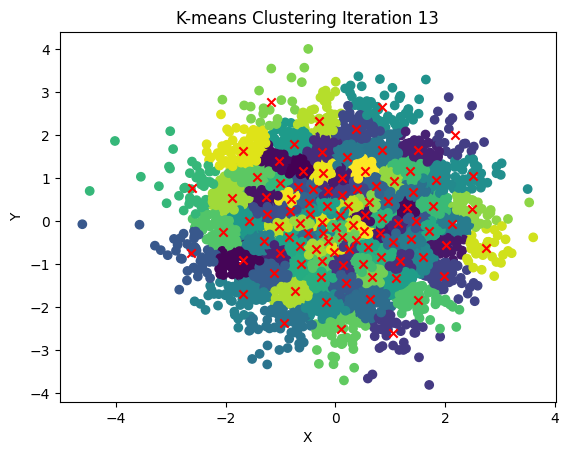

Iter: 14
Iteration 14: Variance = 0.9917171811570992


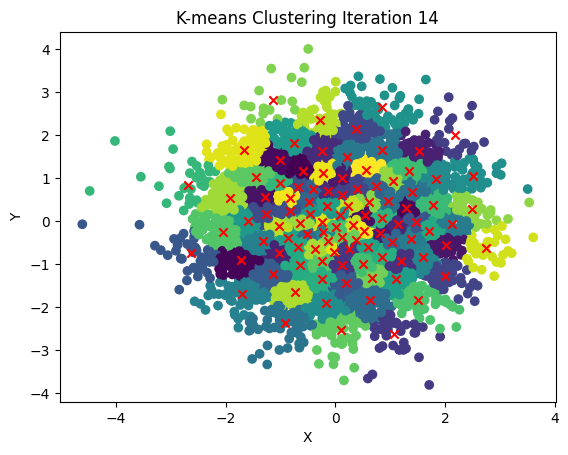

Iter: 15
Iteration 15: Variance = 0.9917171811570992


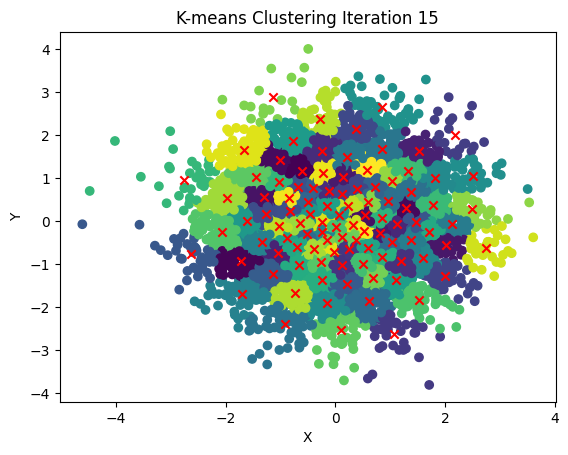

Iter: 16
Iteration 16: Variance = 0.9917171811570992


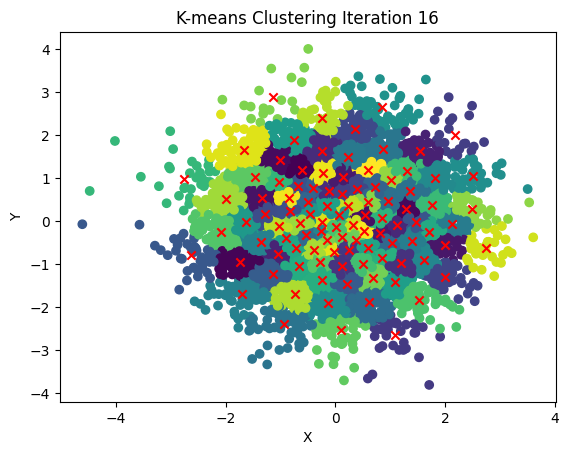

Iter: 17
Iteration 17: Variance = 0.9917171811570992


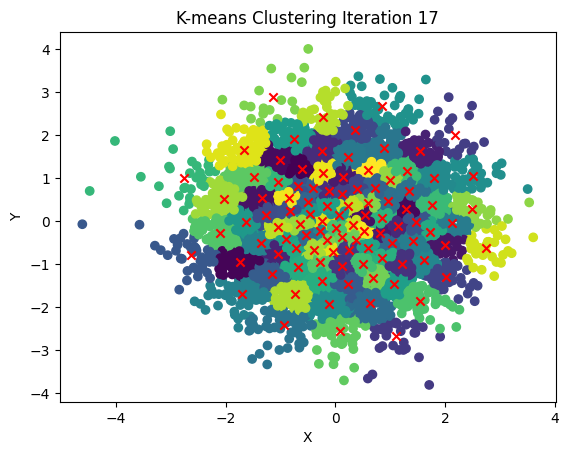

Iter: 18
Iteration 18: Variance = 0.9917171811570992


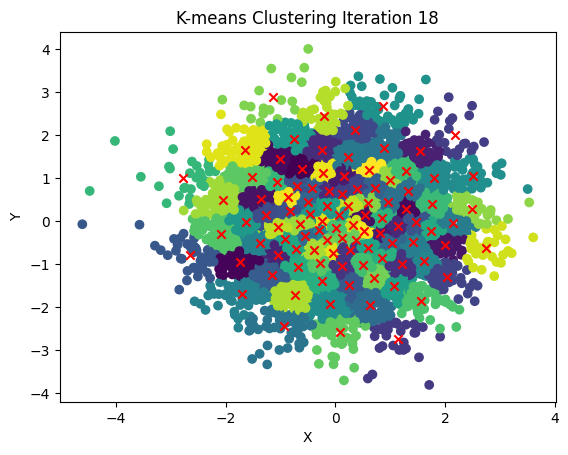

Iter: 19
Iteration 19: Variance = 0.9917171811570992


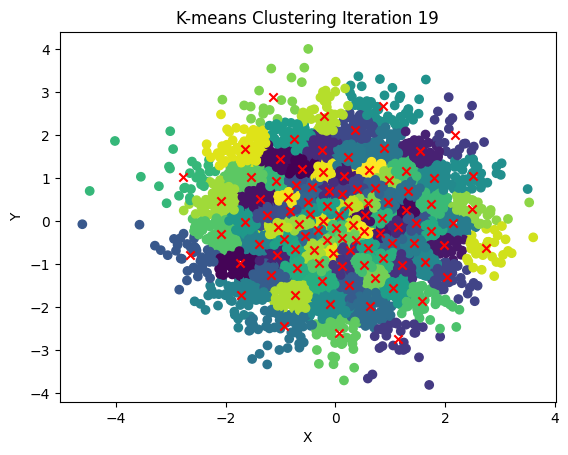

Iter: 20
Iteration 20: Variance = 0.9917171811570992


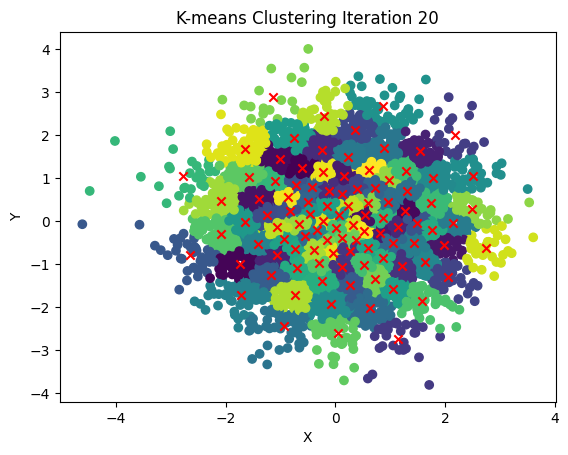

Iter: 21
Iteration 21: Variance = 0.9917171811570992


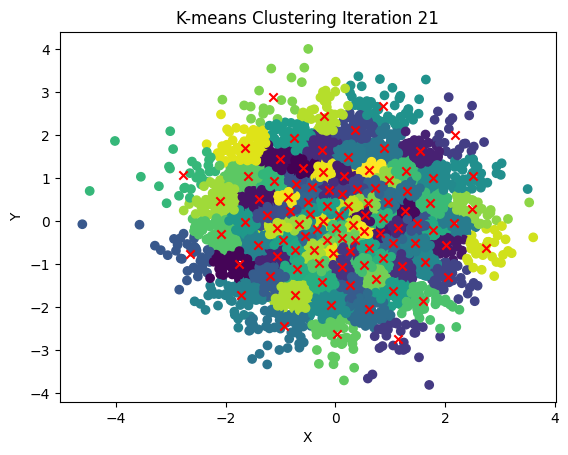

Iter: 22
Iteration 22: Variance = 0.9917171811570992


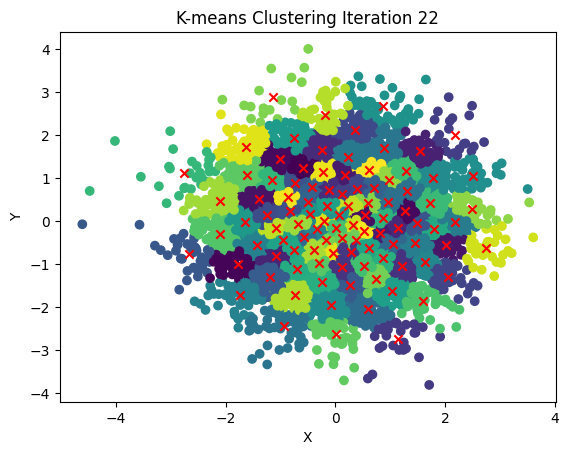

Iter: 23
Iteration 23: Variance = 0.9917171811570992


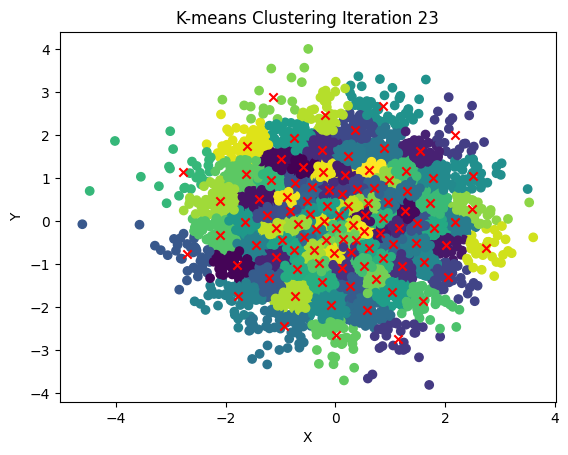

Iter: 24
Iteration 24: Variance = 0.9917171811570992


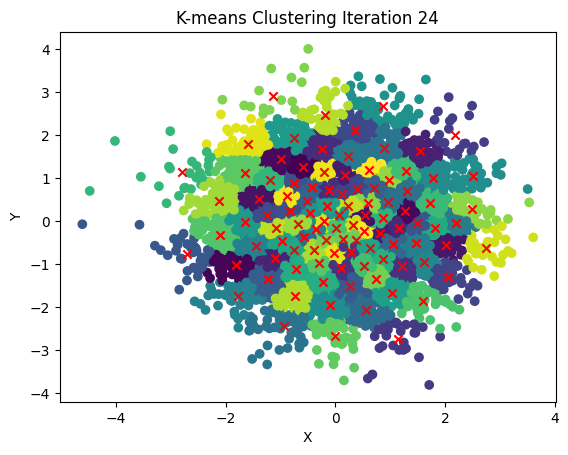

Iter: 25
Iteration 25: Variance = 0.9917171811570992


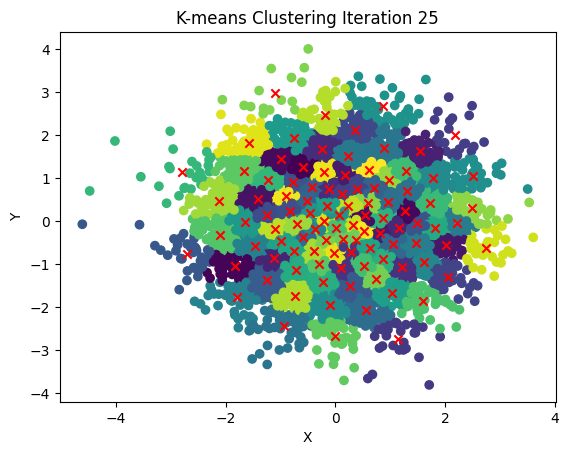

Iter: 26
Iteration 26: Variance = 0.9917171811570992


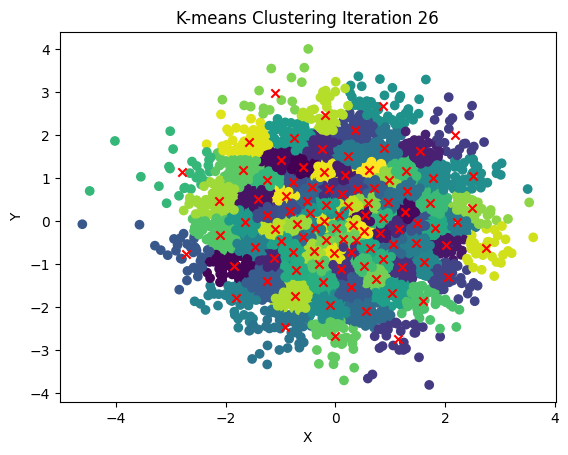

Iter: 27
Iteration 27: Variance = 0.9917171811570992


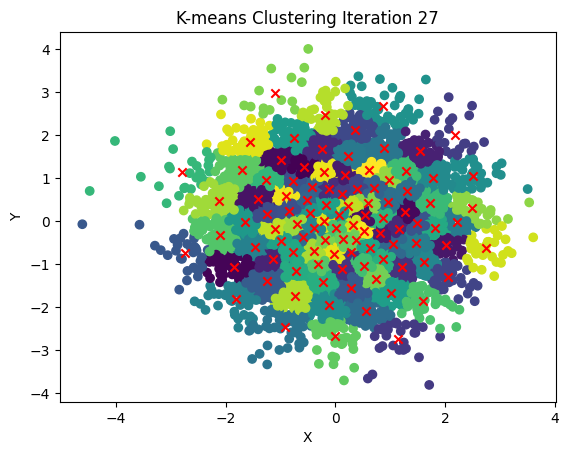

Iter: 28
Iteration 28: Variance = 0.9917171811570992


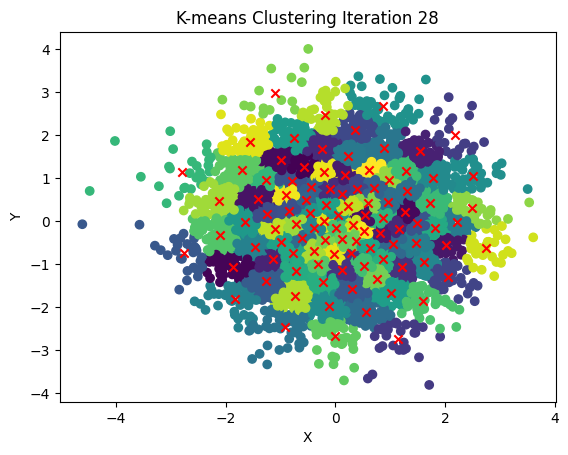

Iter: 29
Iteration 29: Variance = 0.9917171811570992


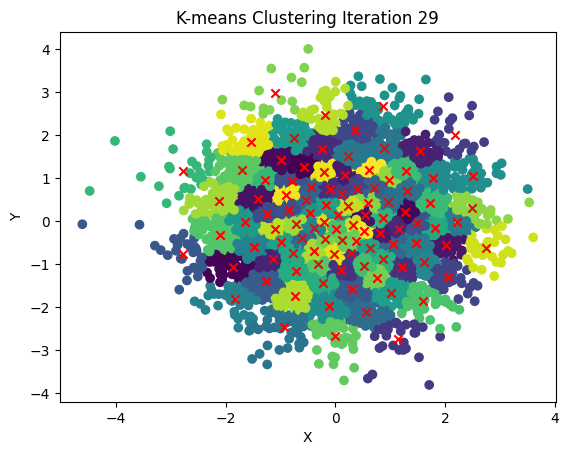

Iter: 30
Iteration 30: Variance = 0.9917171811570992


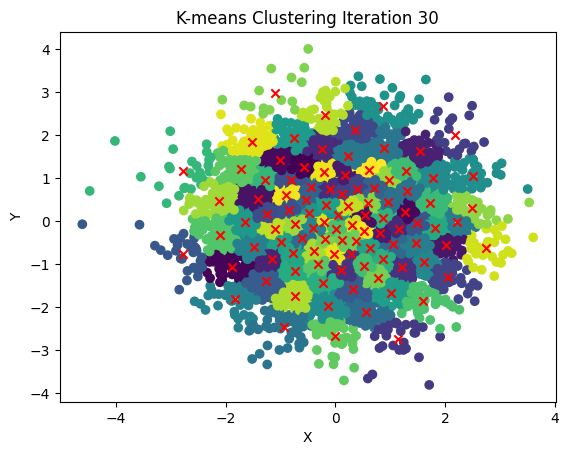

Iter: 31
Iteration 31: Variance = 0.9917171811570992


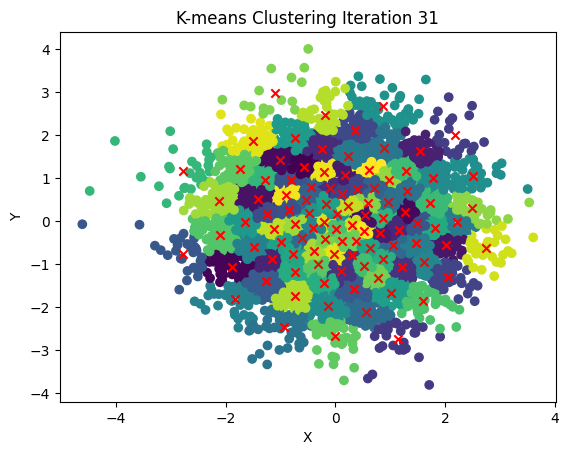

Iter: 32
Iteration 32: Variance = 0.9917171811570992


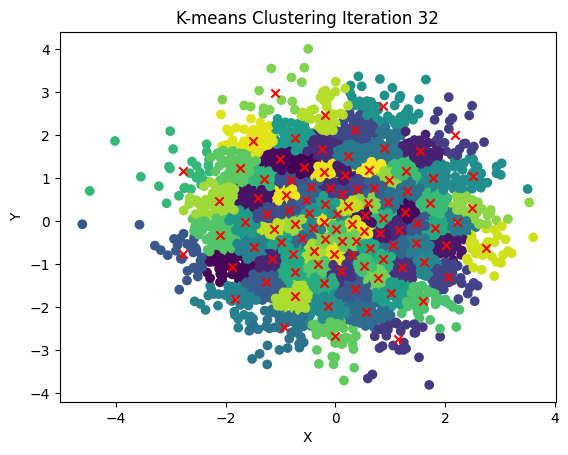

Iter: 33
Iteration 33: Variance = 0.9917171811570992


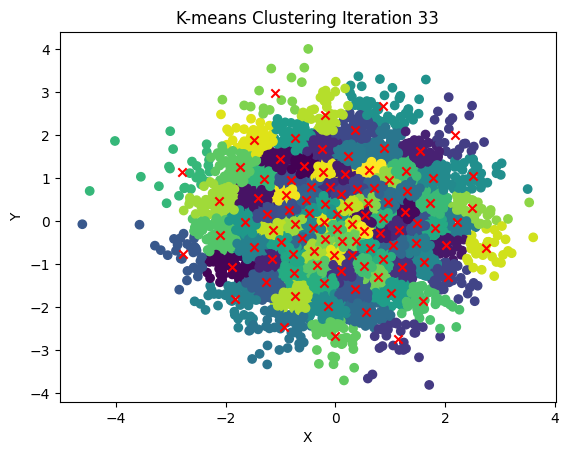

Iter: 34
Iteration 34: Variance = 0.9917171811570992


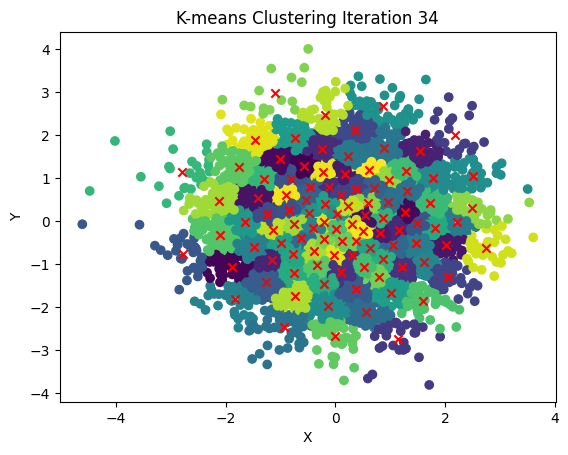

Iter: 35
Iteration 35: Variance = 0.9917171811570992


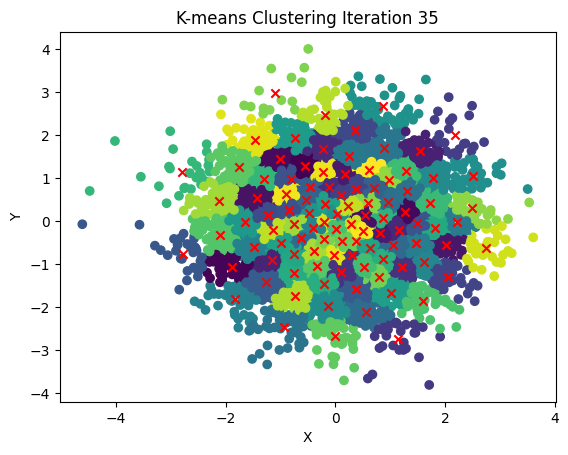

Iter: 36
Iteration 36: Variance = 0.9917171811570992


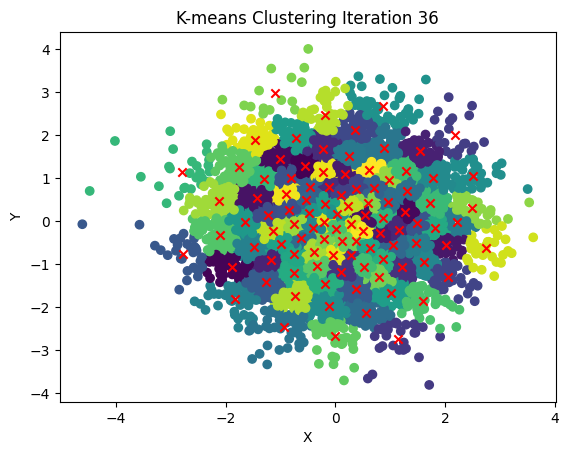

Iter: 37
Iteration 37: Variance = 0.9917171811570992


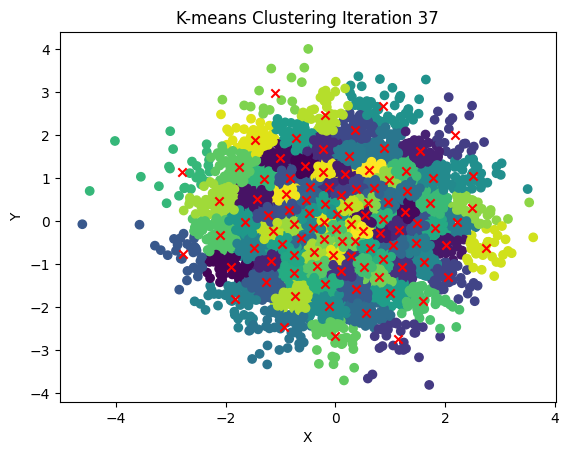

Iter: 38
Iteration 38: Variance = 0.9917171811570992


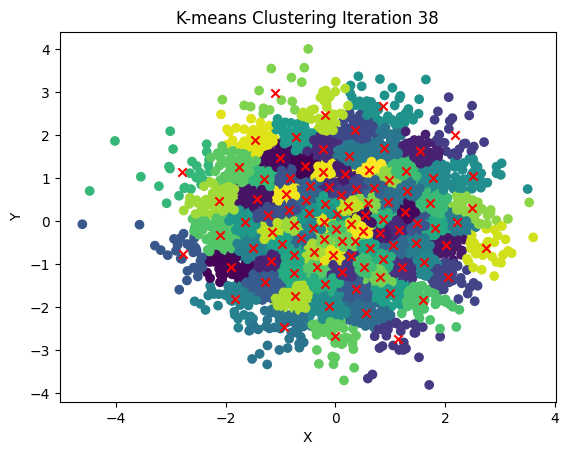

Iter: 39
Iteration 39: Variance = 0.9917171811570992


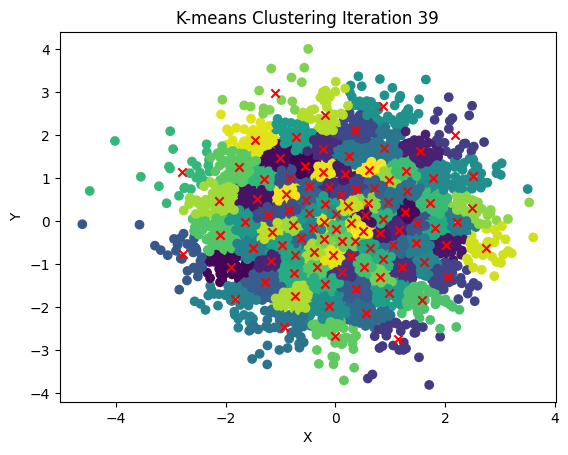

Iter: 40
Iteration 40: Variance = 0.9917171811570992


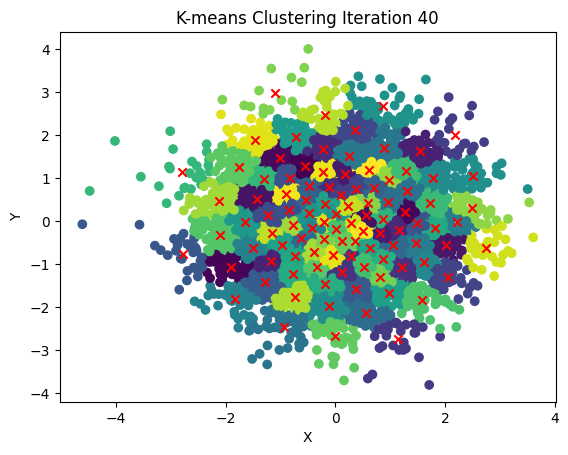

Iter: 41
Iteration 41: Variance = 0.9917171811570992


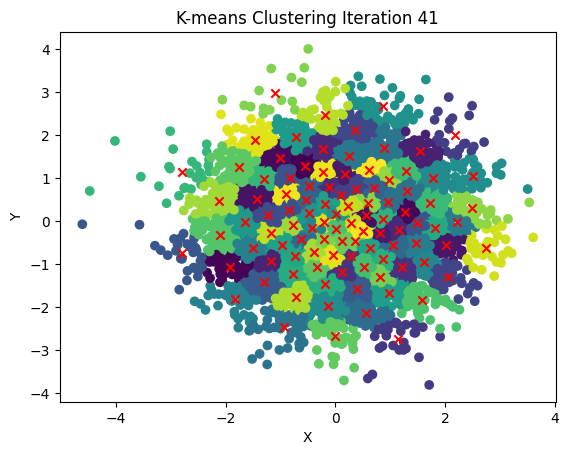

Iter: 42
Iteration 42: Variance = 0.9917171811570992


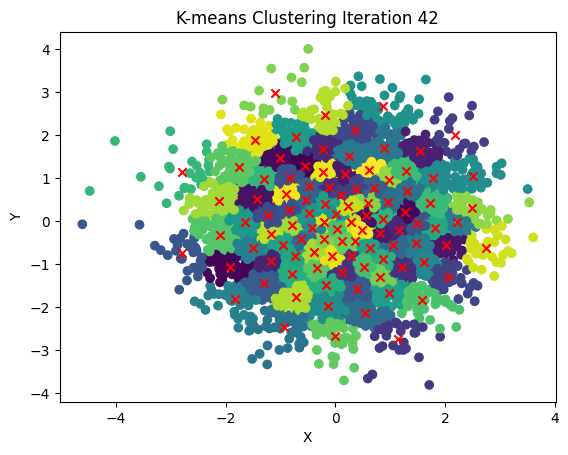

Iter: 43
Iteration 43: Variance = 0.9917171811570992


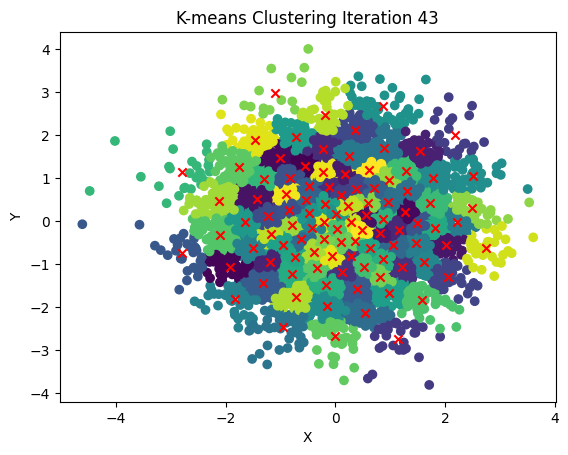

Iter: 44
Iteration 44: Variance = 0.9917171811570992


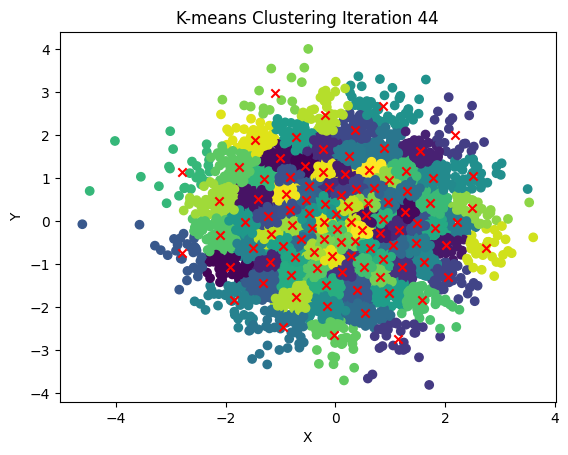

Iter: 45
Iteration 45: Variance = 0.9917171811570992


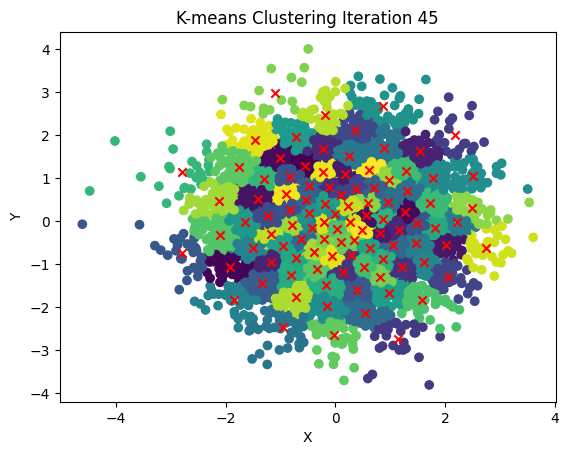

Iter: 46
Iteration 46: Variance = 0.9917171811570992


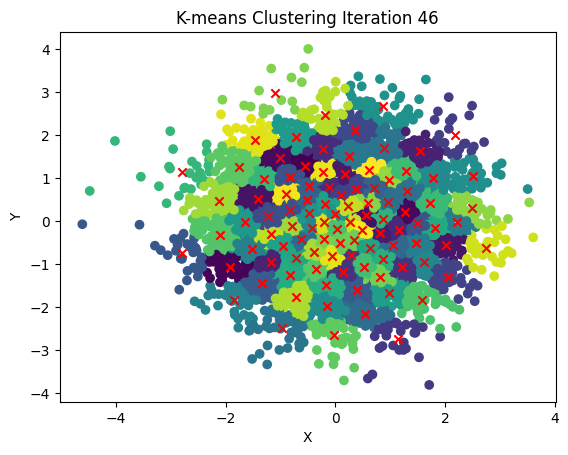

Iter: 47
Iteration 47: Variance = 0.9917171811570992


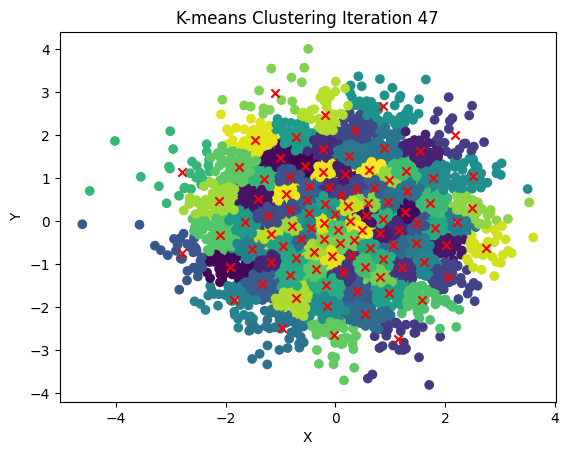

Iter: 48
Iteration 48: Variance = 0.9917171811570992


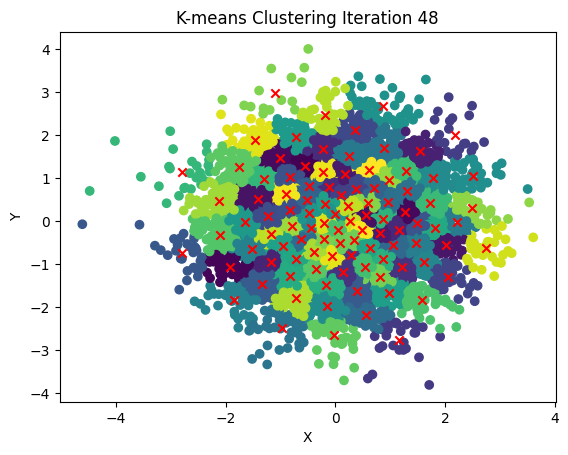

Iter: 49
Iteration 49: Variance = 0.9917171811570992


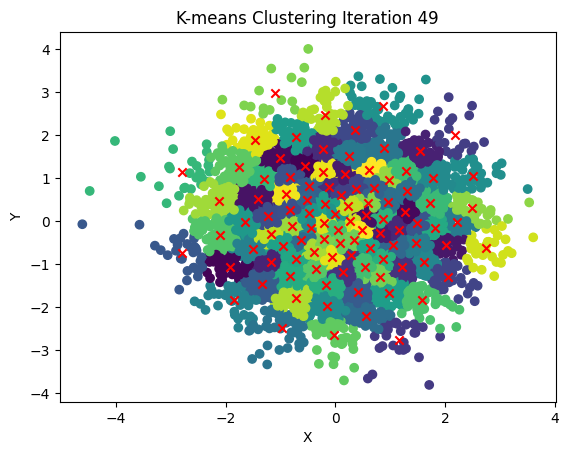

Iter: 50
Iteration 50: Variance = 0.9917171811570992


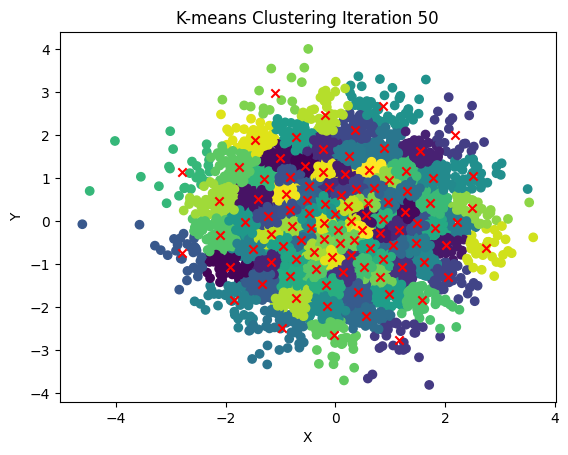

Iter: 51
Iteration 51: Variance = 0.9917171811570992


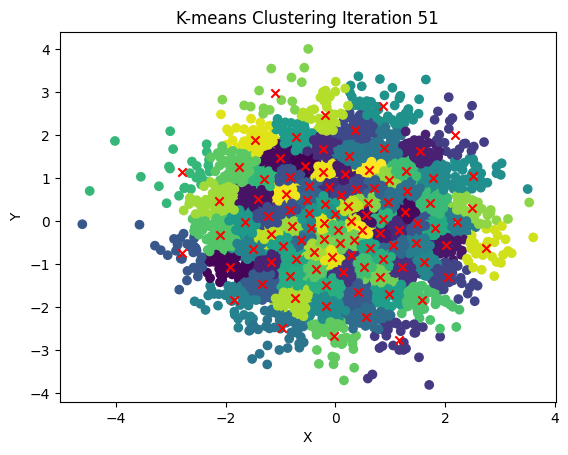

Iter: 52
Iteration 52: Variance = 0.9917171811570992


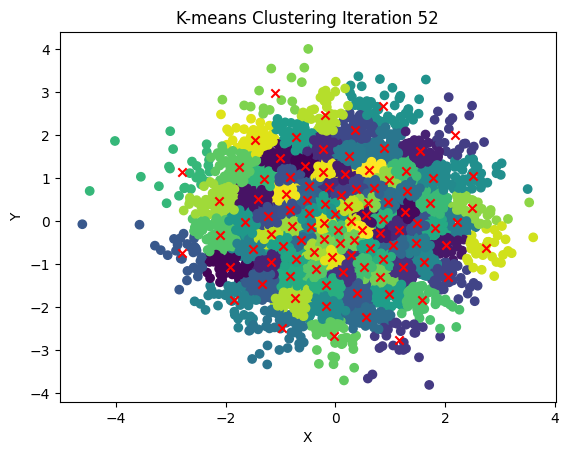

Iter: 53
Iteration 53: Variance = 0.9917171811570992


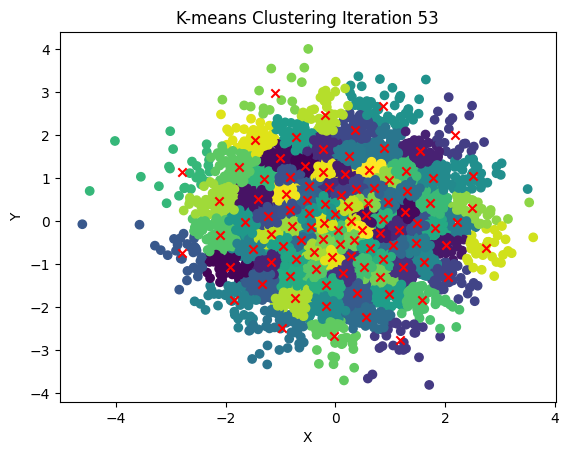

Iter: 54
Iteration 54: Variance = 0.9917171811570992


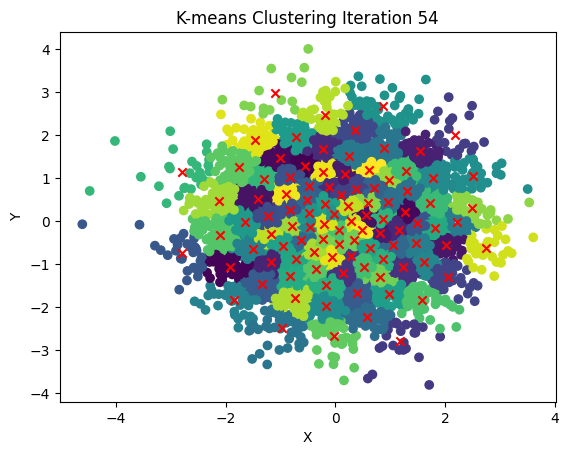

Iter: 55
Iteration 55: Variance = 0.9917171811570992


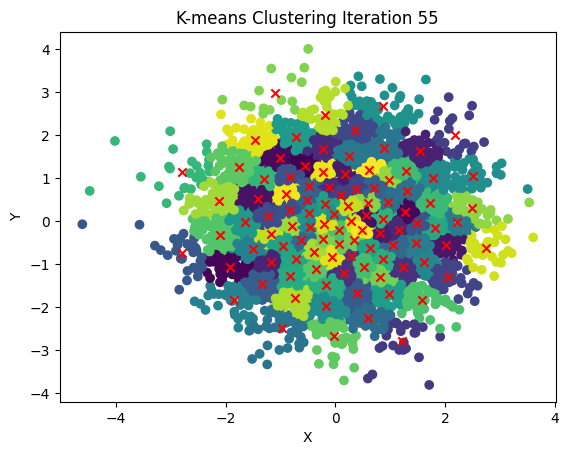

Iter: 56
Iteration 56: Variance = 0.9917171811570992


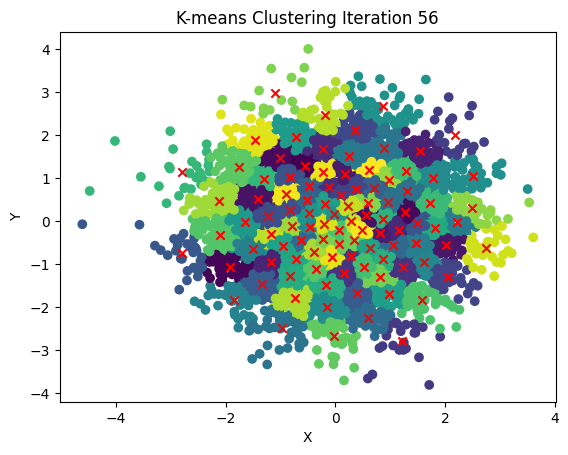

Iter: 57
Iteration 57: Variance = 0.9917171811570992


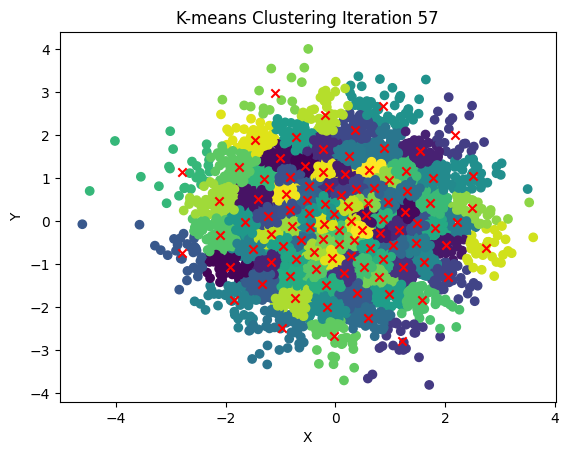

Iter: 58
Iteration 58: Variance = 0.9917171811570992


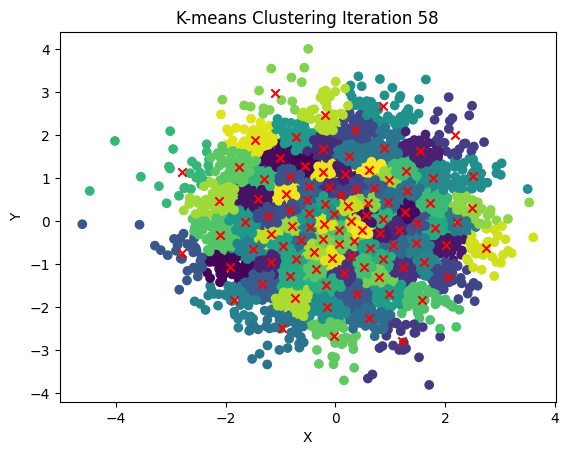

Iter: 59
Iteration 59: Variance = 0.9917171811570992


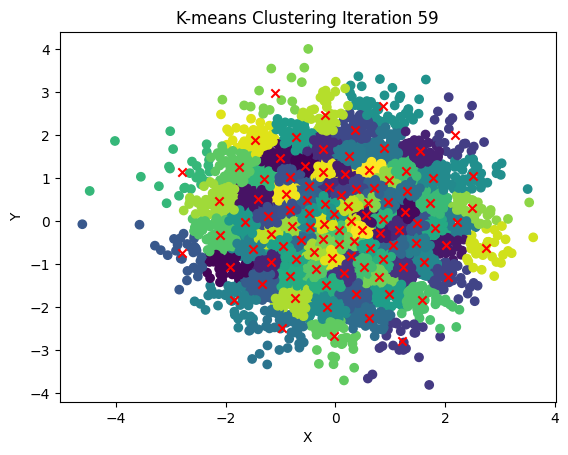

Iter: 60
Iteration 60: Variance = 0.9917171811570992


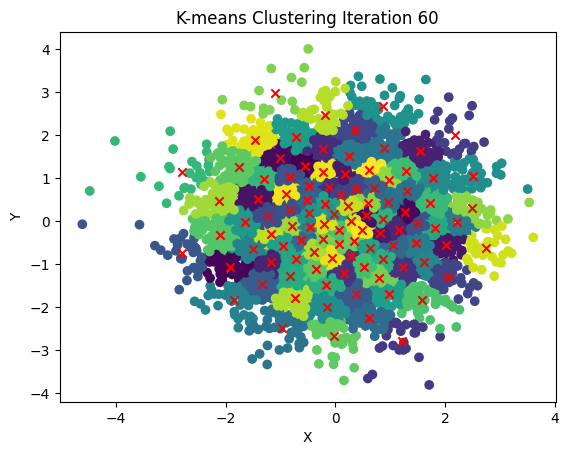

Iter: 61
Iteration 61: Variance = 0.9917171811570992


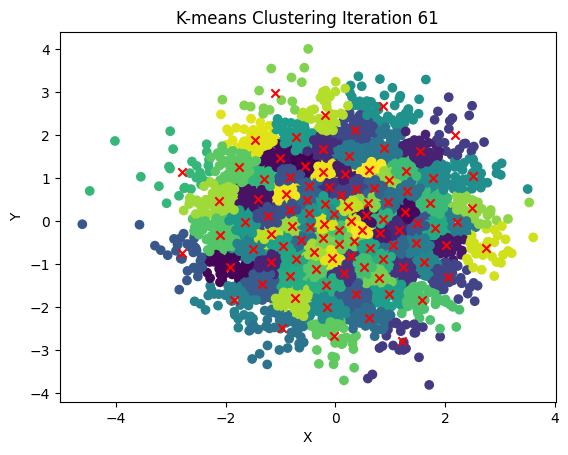

Iter: 62
Iteration 62: Variance = 0.9917171811570992


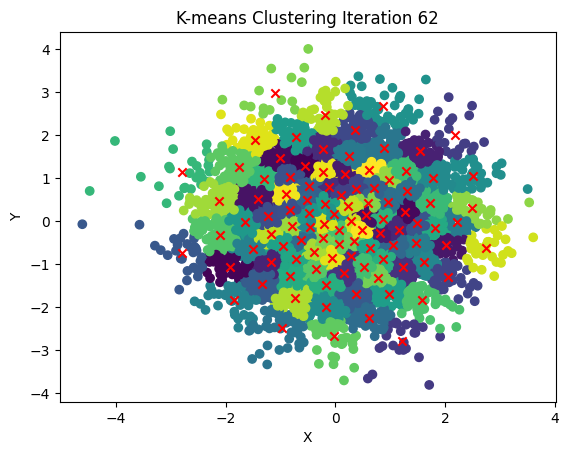

Iter: 63
Iteration 63: Variance = 0.9917171811570992


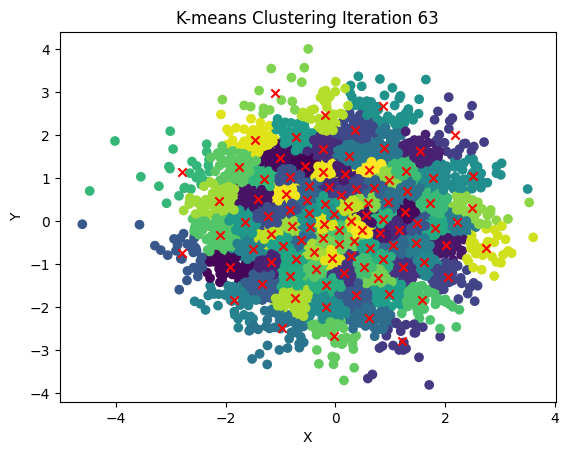

Iter: 64
Iteration 64: Variance = 0.9917171811570992


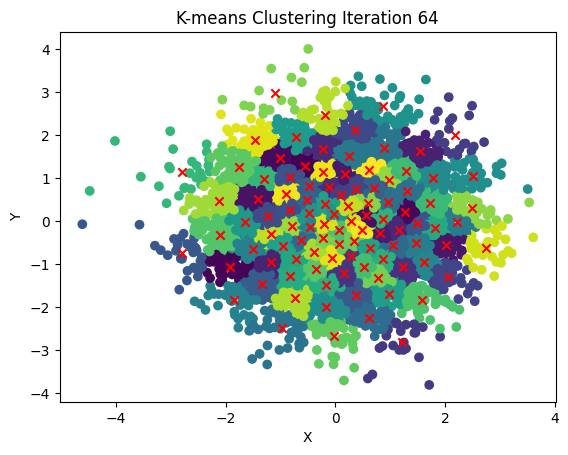

Iter: 65
Iteration 65: Variance = 0.9917171811570992


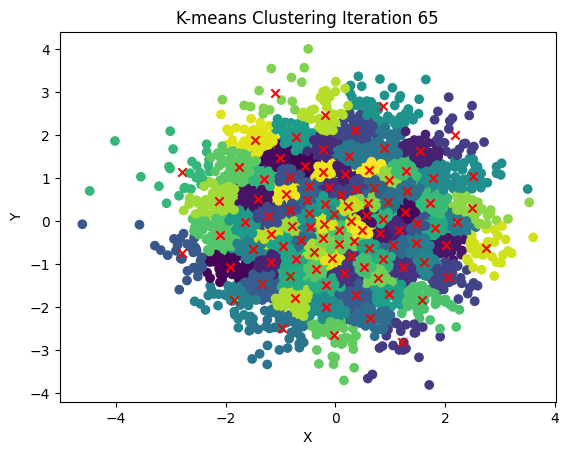

Iter: 66
Iteration 66: Variance = 0.9917171811570992


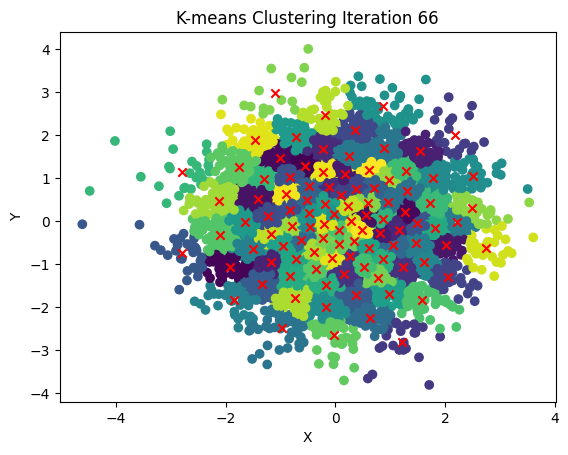

Iter: 67
Iteration 67: Variance = 0.9917171811570992


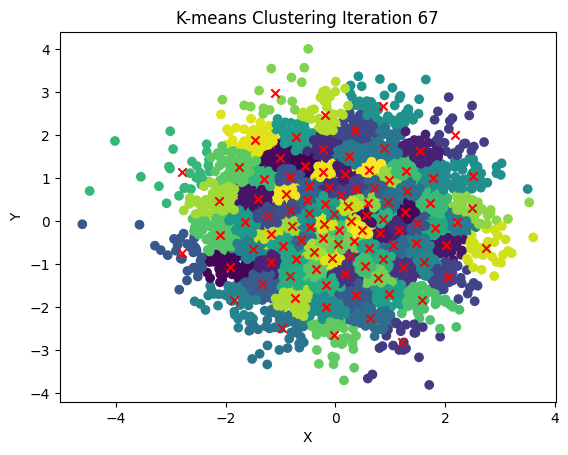

Iter: 68
Iteration 68: Variance = 0.9917171811570992


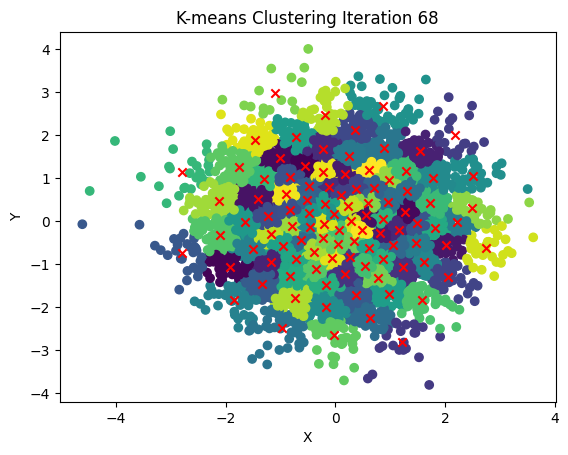

Iter: 69
Iteration 69: Variance = 0.9917171811570992


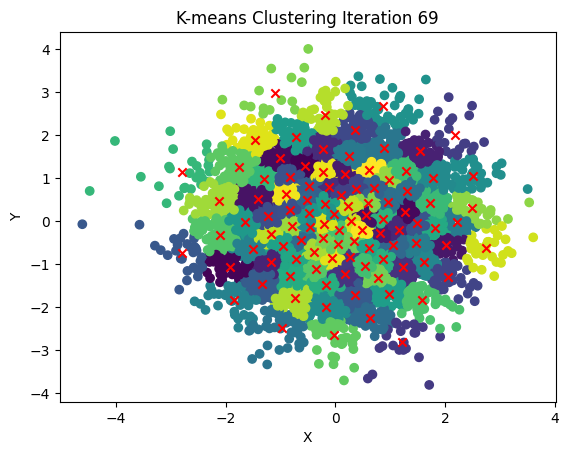

Iter: 70
Iteration 70: Variance = 0.9917171811570992


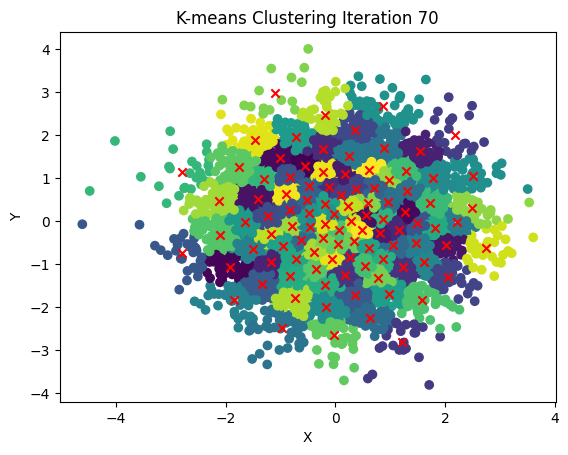

Iter: 71
Iteration 71: Variance = 0.9917171811570992


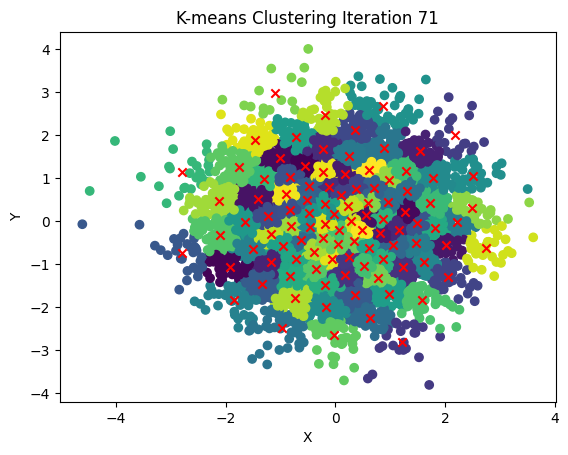

Iter: 72
Iteration 72: Variance = 0.9917171811570992


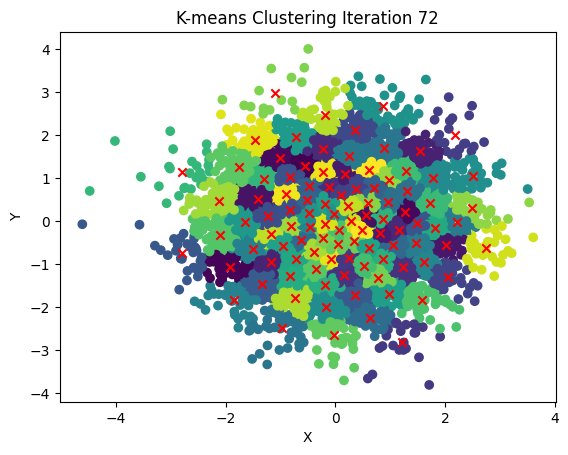

Iter: 73
Iteration 73: Variance = 0.9917171811570992


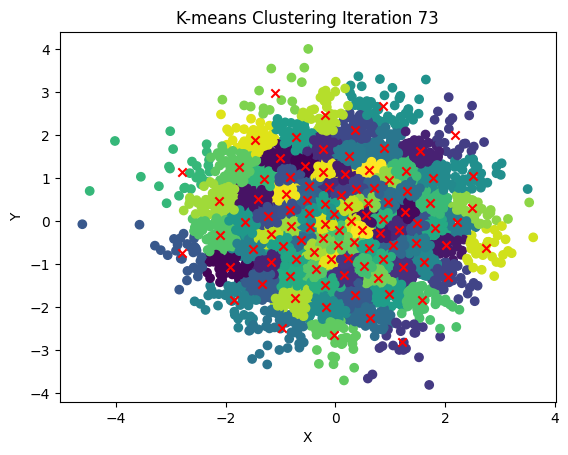

Iter: 74
Iteration 74: Variance = 0.9917171811570992


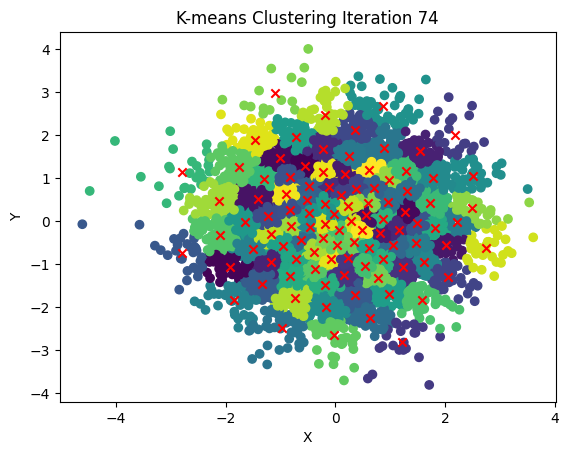

Iter: 75
Iteration 75: Variance = 0.9917171811570992


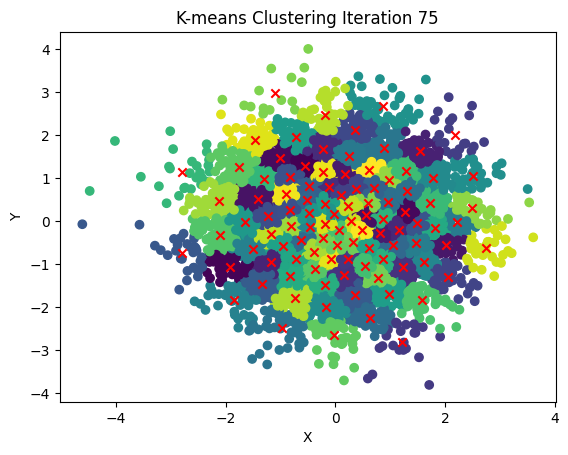

Iter: 76
Iteration 76: Variance = 0.9917171811570992


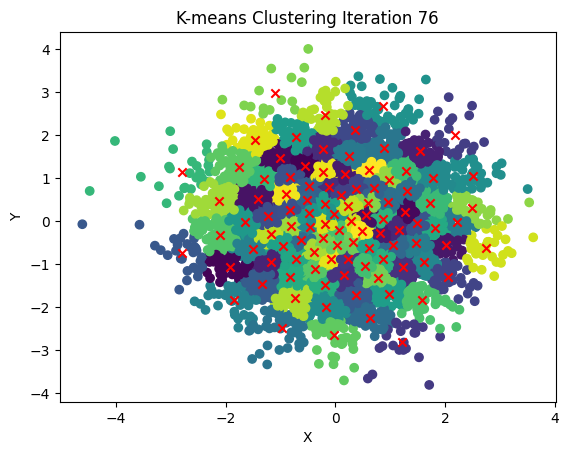

Iter: 77
Iteration 77: Variance = 0.9917171811570992


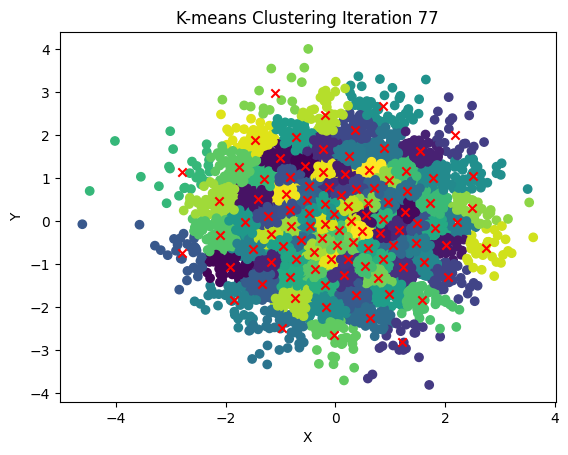

Iter: 78
Iteration 78: Variance = 0.9917171811570992


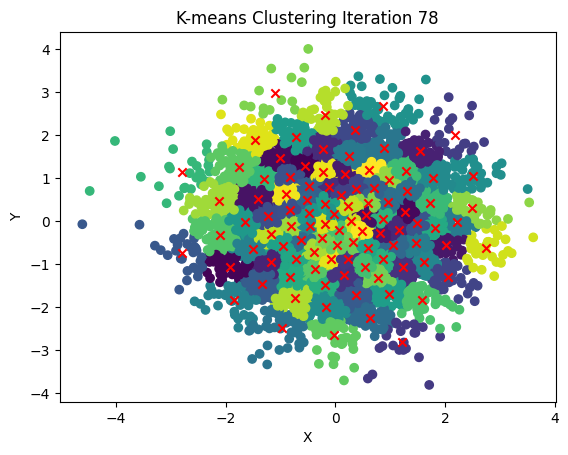

Iter: 79
Iteration 79: Variance = 0.9917171811570992


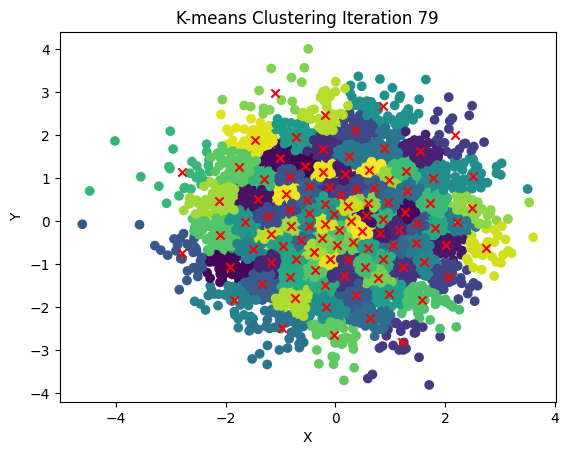

Iter: 80
Iteration 80: Variance = 0.9917171811570992


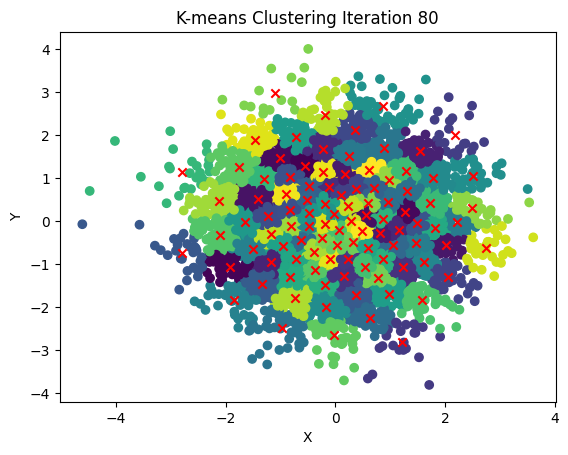

Iter: 81
Iteration 81: Variance = 0.9917171811570992


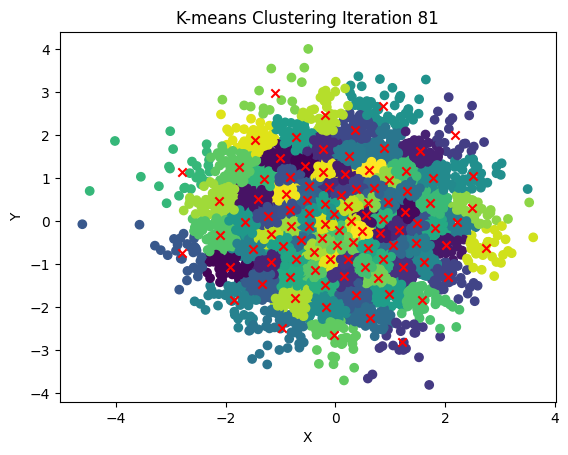

Iter: 82
Iteration 82: Variance = 0.9917171811570992


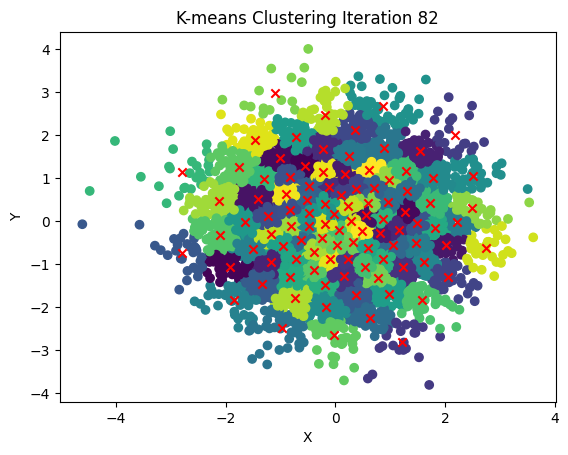

Iter: 83
Iteration 83: Variance = 0.9917171811570992


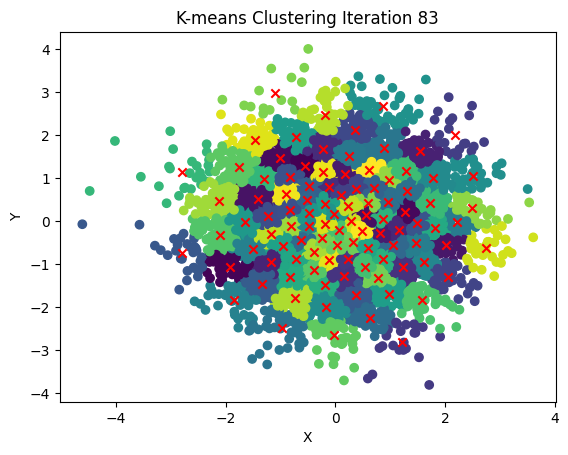

Iter: 84
Iteration 84: Variance = 0.9917171811570992


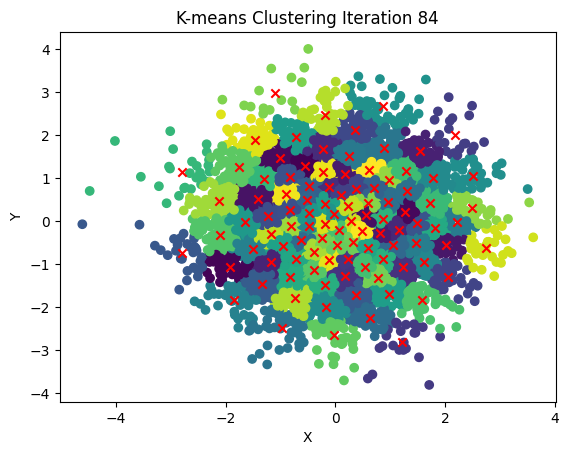

Iter: 85
Iteration 85: Variance = 0.9917171811570992


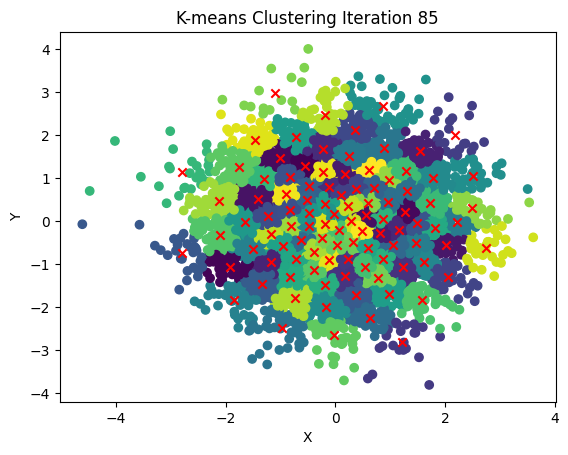

Iter: 86
Iteration 86: Variance = 0.9917171811570992


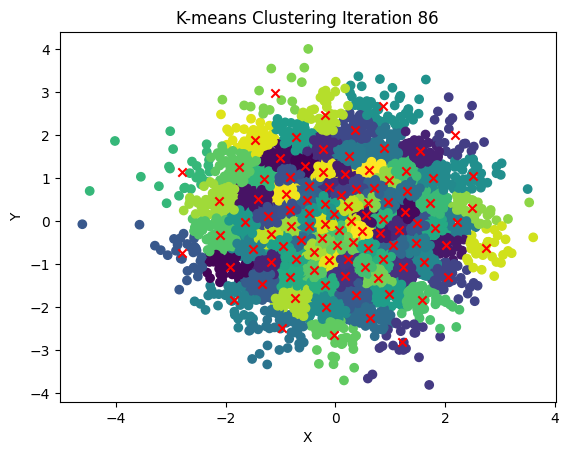

Iter: 87
Iteration 87: Variance = 0.9917171811570992


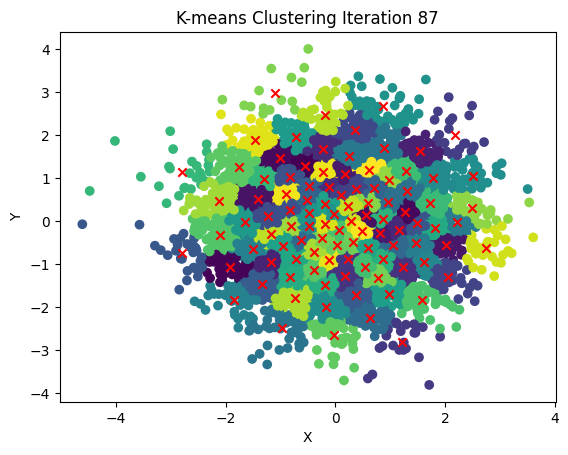

Iter: 88
Iteration 88: Variance = 0.9917171811570992


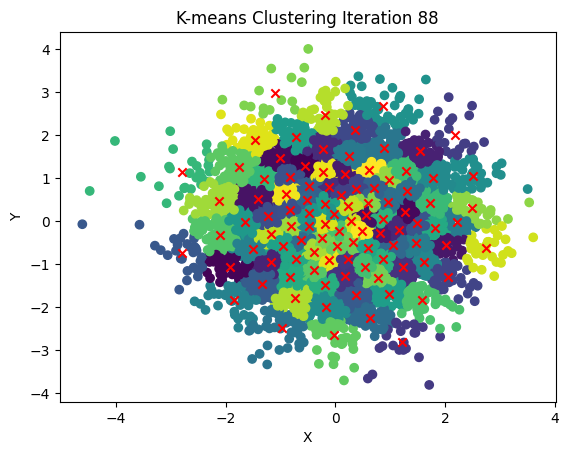

Iter: 89
Iteration 89: Variance = 0.9917171811570992


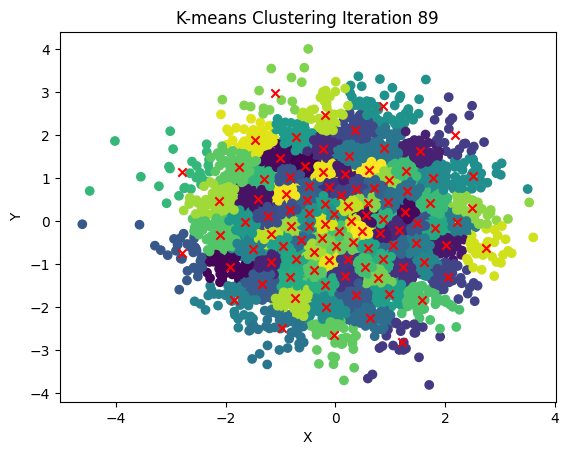

Iter: 90
Iteration 90: Variance = 0.9917171811570992


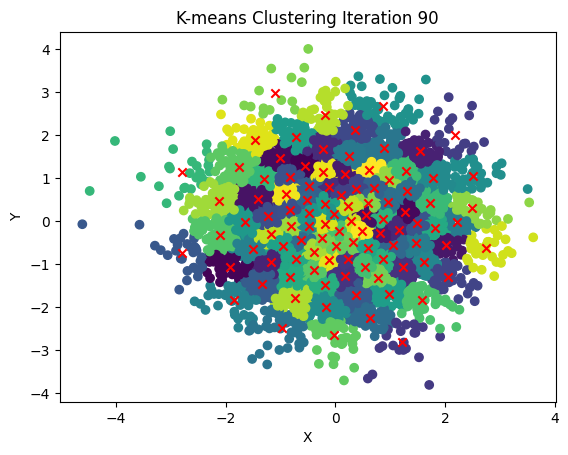

Iter: 91
Iteration 91: Variance = 0.9917171811570992


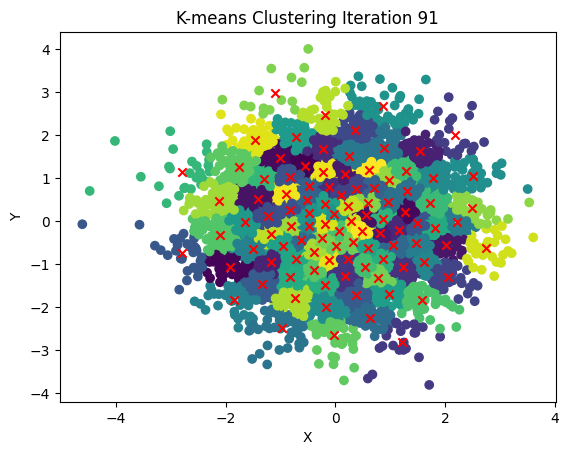

Iter: 92
Iteration 92: Variance = 0.9917171811570992


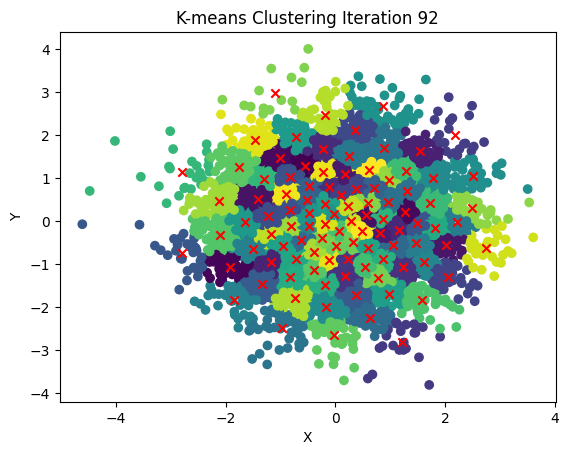

Iter: 93
Iteration 93: Variance = 0.9917171811570992


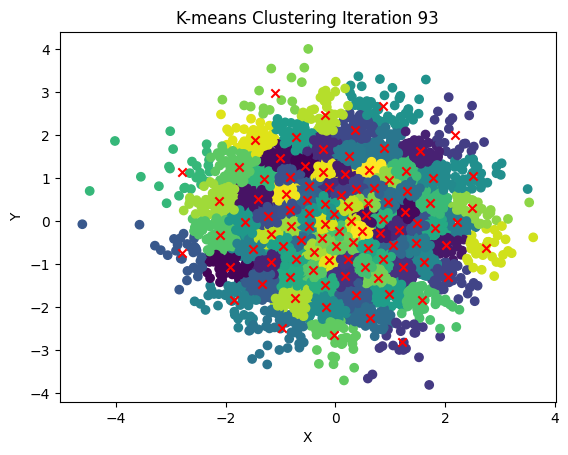

Iter: 94
Iteration 94: Variance = 0.9917171811570992


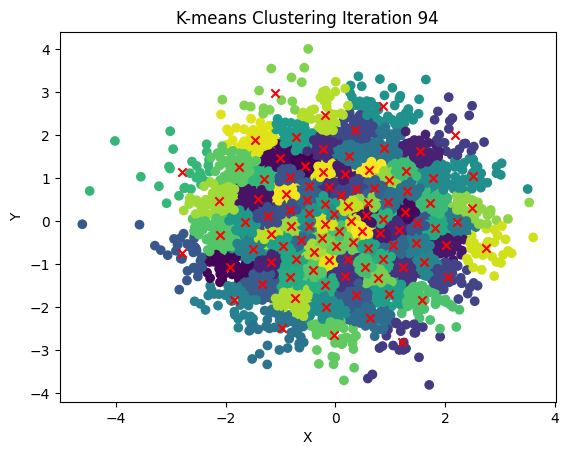

Iter: 95
Iteration 95: Variance = 0.9917171811570992


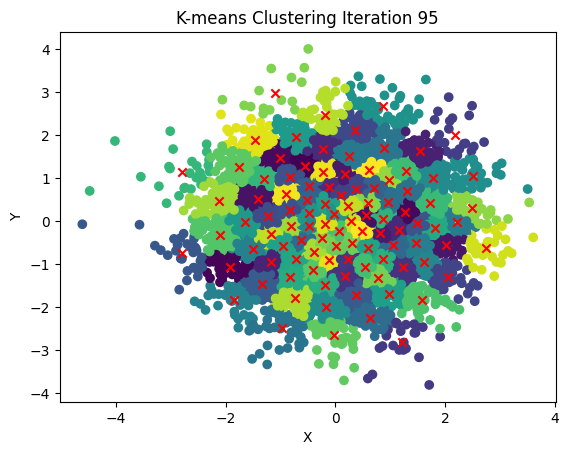

Iter: 96
Iteration 96: Variance = 0.9917171811570992


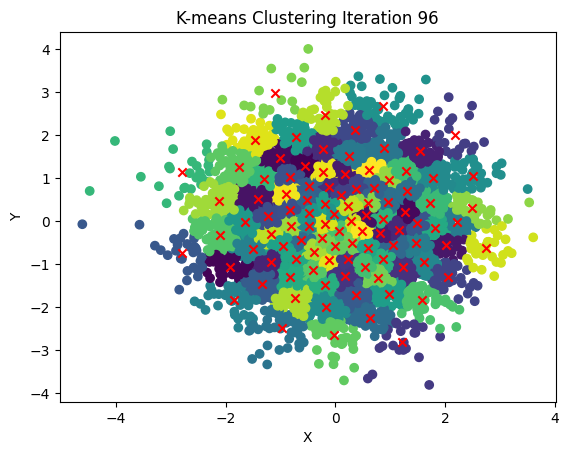

Iter: 97
Iteration 97: Variance = 0.9917171811570992


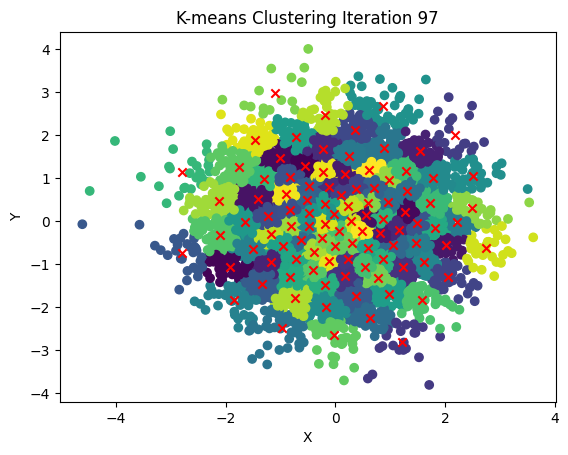

Iter: 98
Iteration 98: Variance = 0.9917171811570992


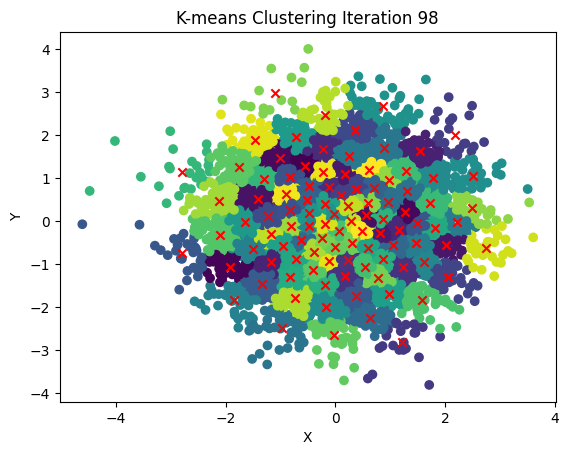

Iter: 99
Iteration 99: Variance = 0.9917171811570992


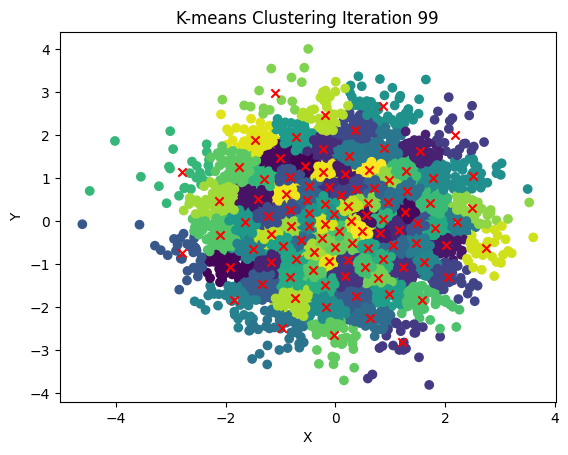

Iter: 100
Iteration 100: Variance = 0.9917171811570992


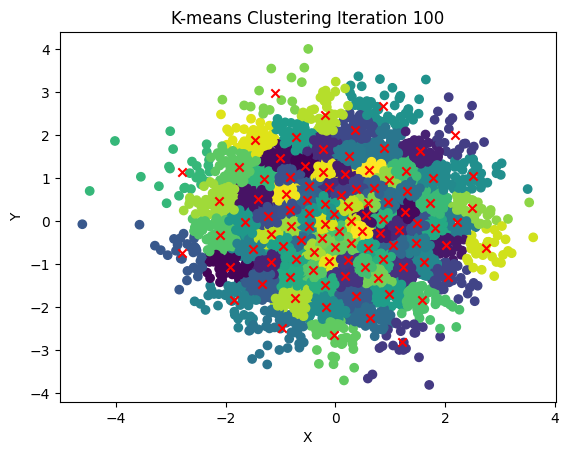

[[-0.55375603  1.29532049]
 [-1.92645823 -1.0632089 ]
 [ 1.27025031  0.20888133]
 [-1.00302259  1.47813689]
 [ 0.56377632  0.13943694]
 [-1.4180628   0.52050038]
 [ 2.01837286 -0.55331385]
 [ 0.18487914  1.10085149]
 [ 0.80686041 -0.27915138]
 [ 1.53843706  1.62460486]
 [-1.17517372 -0.95320788]
 [ 1.16512003 -0.19937686]
 [-0.22776413  1.67118638]
 [-0.11405186  0.80075867]
 [ 1.22694458 -1.07752639]
 [ 0.17931172 -1.28323105]
 [ 0.22486079 -0.90234917]
 [ 1.22353422 -2.82133625]
 [ 2.1763415   2.00772023]
 [ 0.0998495   0.61033125]
 [ 2.04704967 -1.30578285]
 [ 0.37919858  0.75854022]
 [ 0.36590423  2.12653979]
 [-1.2210158   0.12537171]
 [-0.83387146  0.2589661 ]
 [-0.82093219  1.02280553]
 [ 1.49819094 -0.04704158]
 [-2.78906056 -0.753445  ]
 [ 0.3704209  -1.73573147]
 [-1.33330365 -1.45355606]
 [-0.47899378  0.82040794]
 [ 0.71516362  0.76770142]
 [-0.52433994  0.49591672]
 [ 1.05134322 -0.5538075 ]
 [-0.62139677 -0.43014694]
 [ 0.62700992 -2.25401182]
 [ 0.9659026   0.4521726 ]
 

In [50]:
from sklearn.mixture import GaussianMixture
import numpy as np

#GMM parameters
K = 3  
n_samples = 10000  

#data
data = np.random.randn(n_samples, 2)  

# Gaussian Mixture
gmm = GaussianMixture(n_components=K)

gmm.fit(data)

# Generate data from GMM
gen_data, _ = gmm.sample(n_samples)


print(gen_data)

num_clusters = 100  # Number of clusters
data_numpy=data

cen, labels = kmeans_cluster(data_numpy, num_clusters)
print(cen,labels)


[[ 0.40298779  0.94043204]
 [ 1.61195479  0.90911687]
 [ 0.59339991 -0.43862827]
 ...
 [ 0.90418688 -2.54977994]
 [-0.25975686 -0.75545035]
 [ 0.81035461 -1.25715911]]
Iter: 1
Iteration 1: Variance = 0.9878641932783596


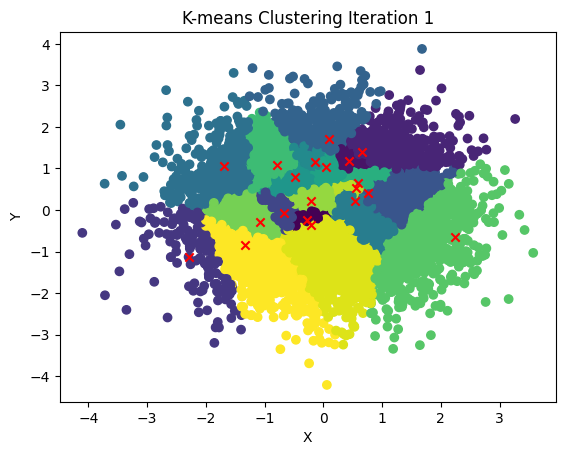

Iter: 2
Iteration 2: Variance = 0.9878641932783596


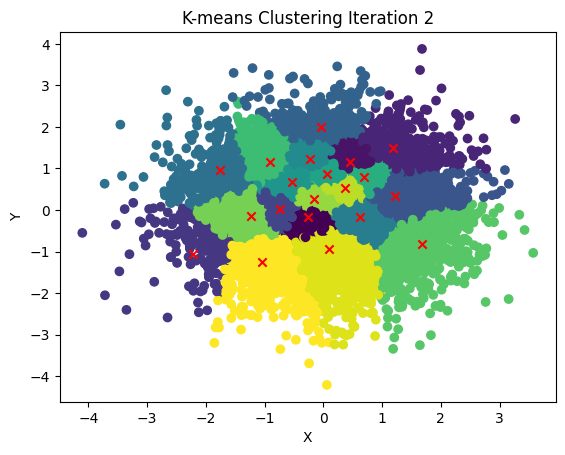

Iter: 3
Iteration 3: Variance = 0.9878641932783596


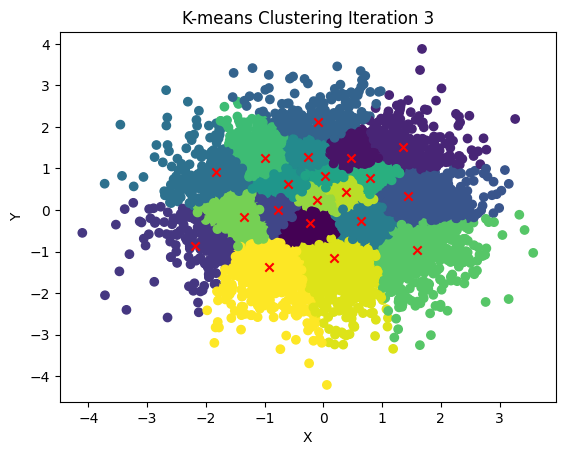

Iter: 4
Iteration 4: Variance = 0.9878641932783596


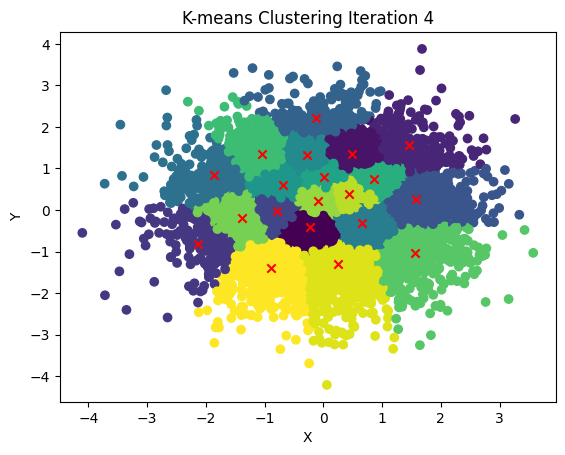

Iter: 5
Iteration 5: Variance = 0.9878641932783596


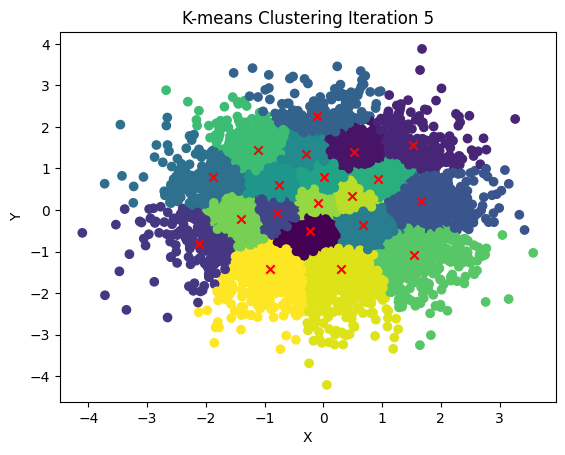

Iter: 6
Iteration 6: Variance = 0.9878641932783596


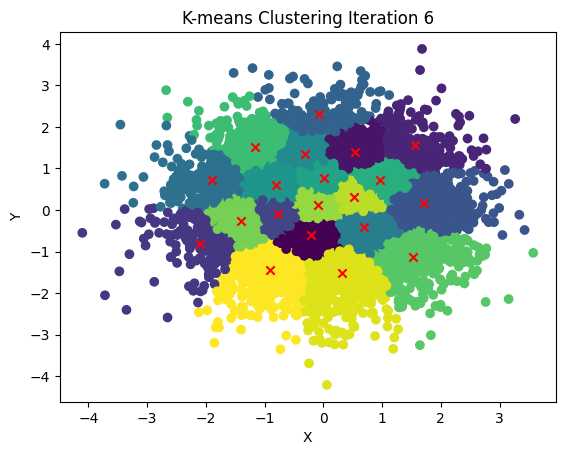

Iter: 7
Iteration 7: Variance = 0.9878641932783596


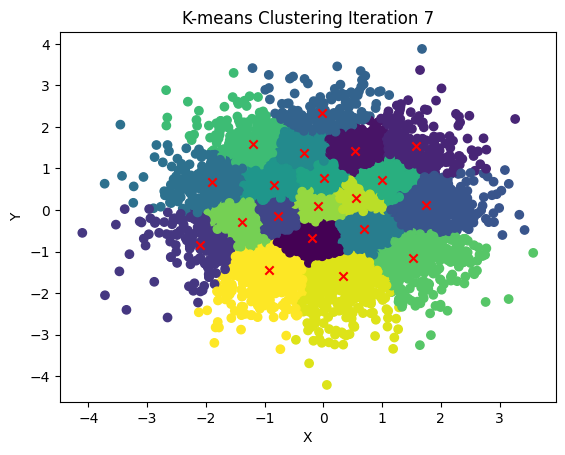

Iter: 8
Iteration 8: Variance = 0.9878641932783596


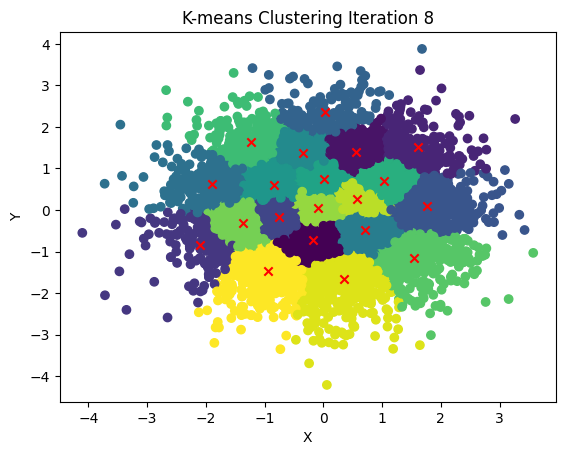

Iter: 9
Iteration 9: Variance = 0.9878641932783596


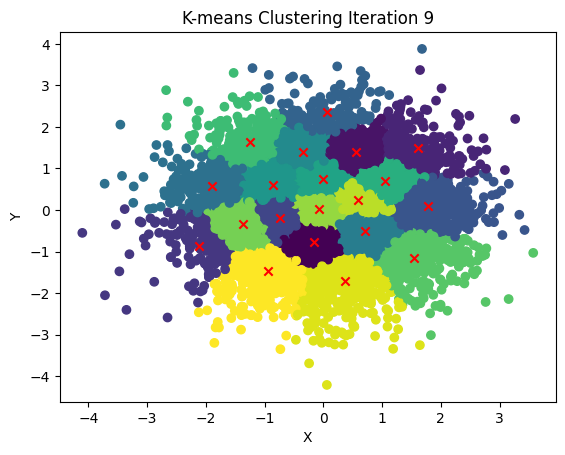

Iter: 10
Iteration 10: Variance = 0.9878641932783596


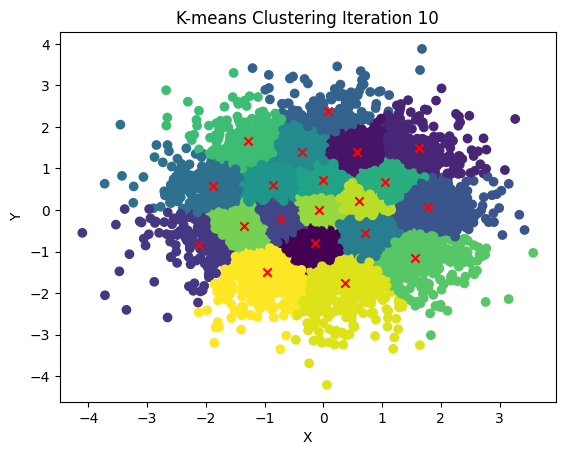

Iter: 11
Iteration 11: Variance = 0.9878641932783596


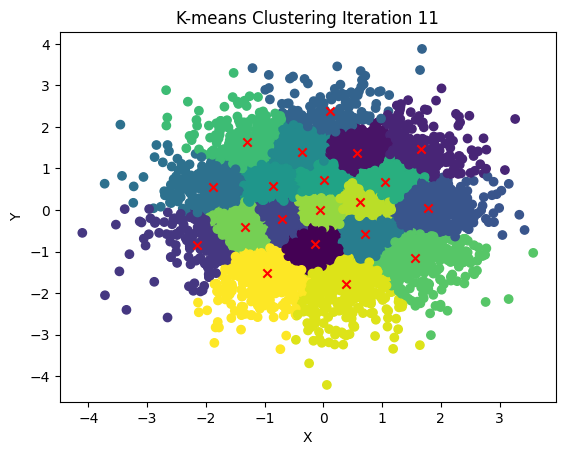

Iter: 12
Iteration 12: Variance = 0.9878641932783596


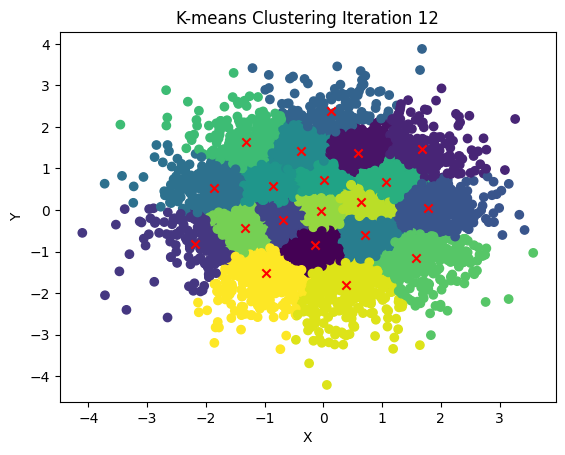

Iter: 13
Iteration 13: Variance = 0.9878641932783596


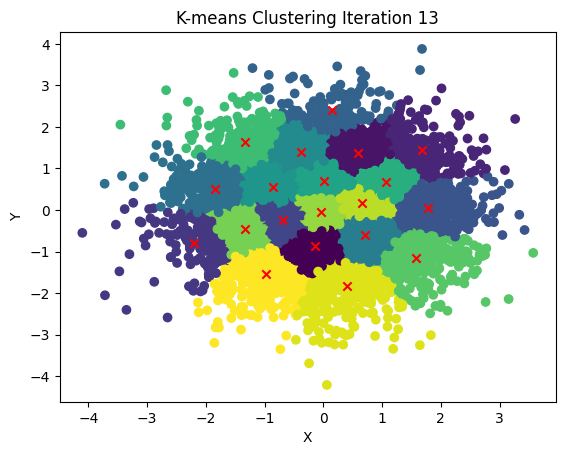

Iter: 14
Iteration 14: Variance = 0.9878641932783596


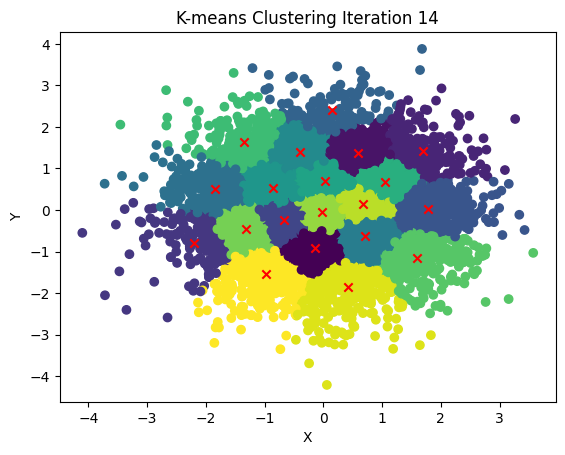

Iter: 15
Iteration 15: Variance = 0.9878641932783596


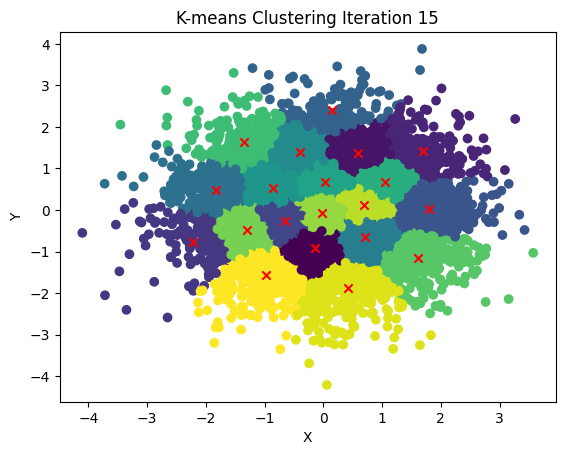

Iter: 16
Iteration 16: Variance = 0.9878641932783596


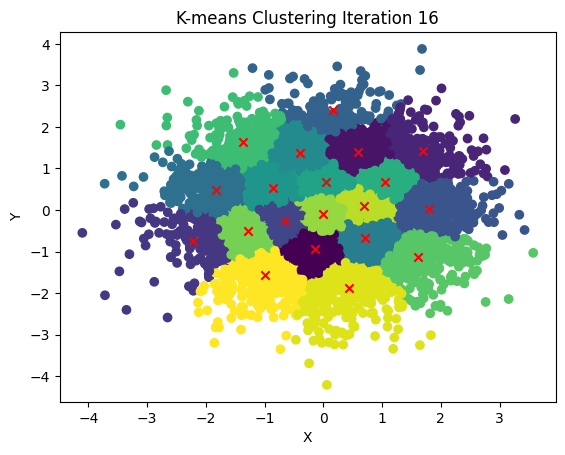

Iter: 17
Iteration 17: Variance = 0.9878641932783596


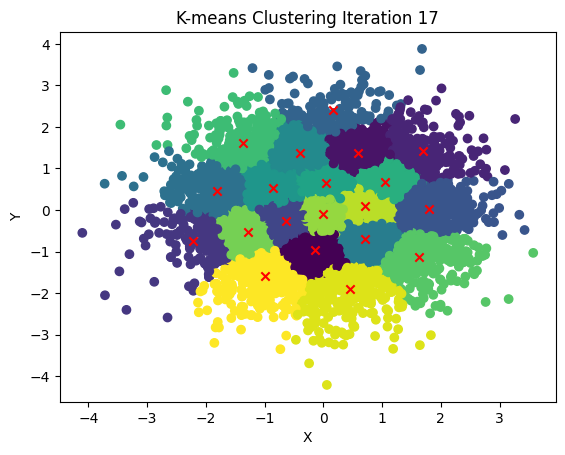

Iter: 18
Iteration 18: Variance = 0.9878641932783596


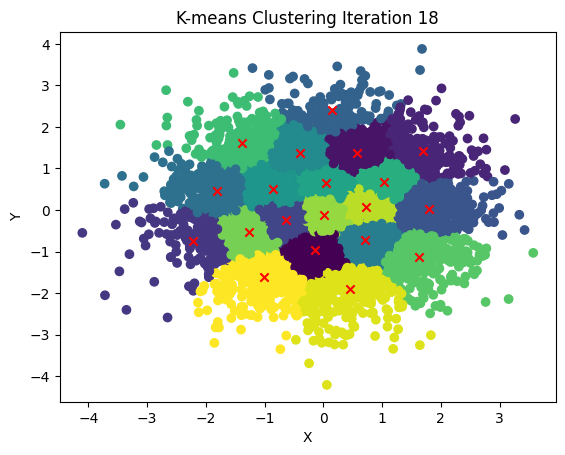

Iter: 19
Iteration 19: Variance = 0.9878641932783596


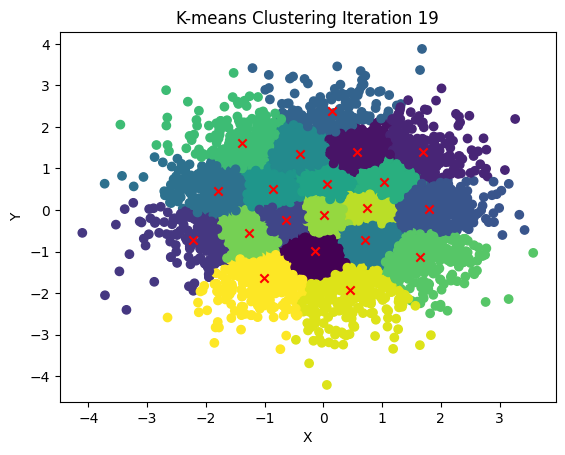

Iter: 20
Iteration 20: Variance = 0.9878641932783596


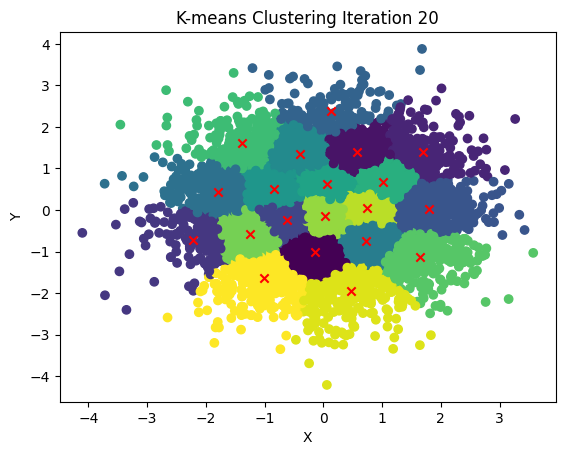

Iter: 21
Iteration 21: Variance = 0.9878641932783596


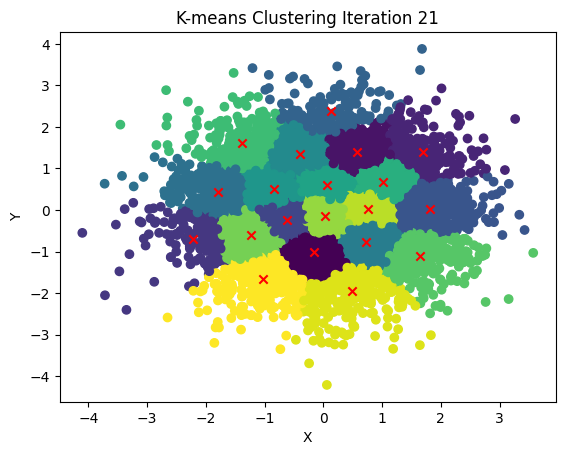

Iter: 22
Iteration 22: Variance = 0.9878641932783596


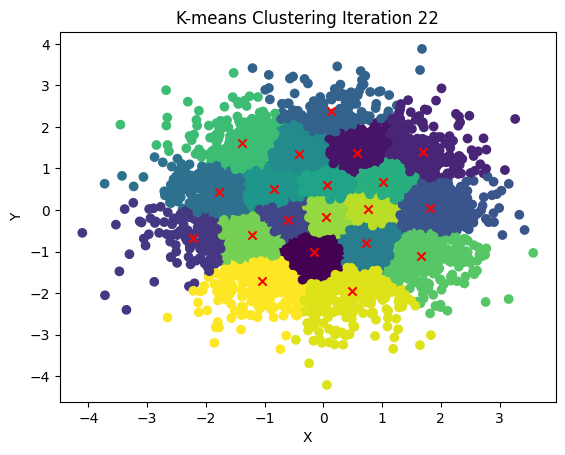

Iter: 23
Iteration 23: Variance = 0.9878641932783596


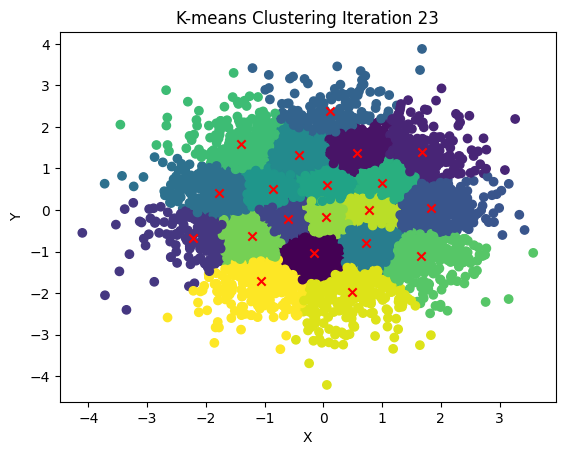

Iter: 24
Iteration 24: Variance = 0.9878641932783596


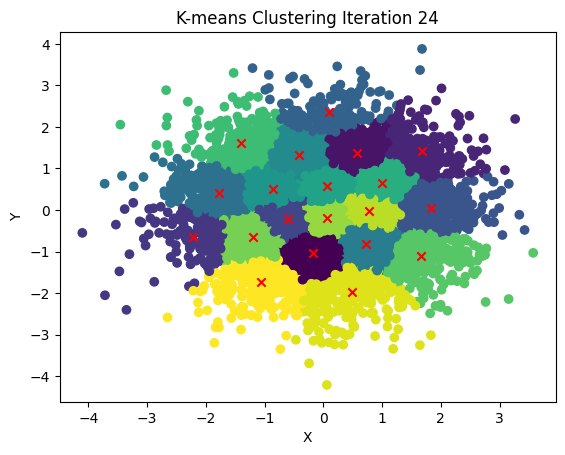

Iter: 25
Iteration 25: Variance = 0.9878641932783596


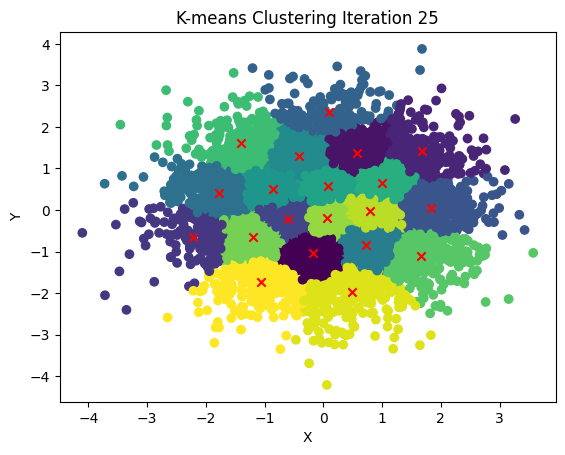

Iter: 26
Iteration 26: Variance = 0.9878641932783596


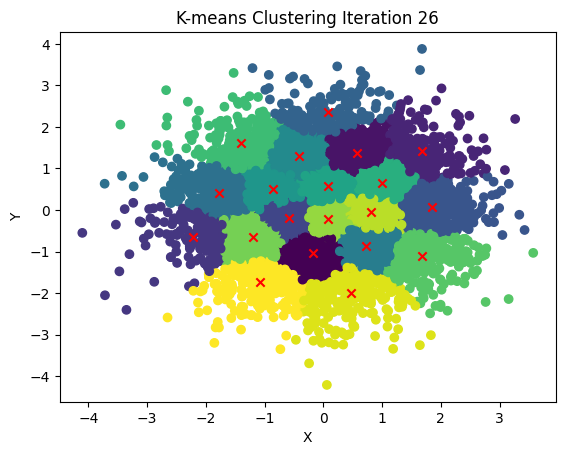

Iter: 27
Iteration 27: Variance = 0.9878641932783596


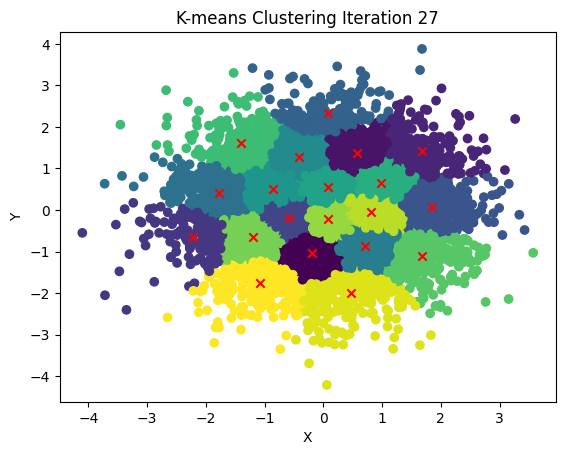

Iter: 28
Iteration 28: Variance = 0.9878641932783596


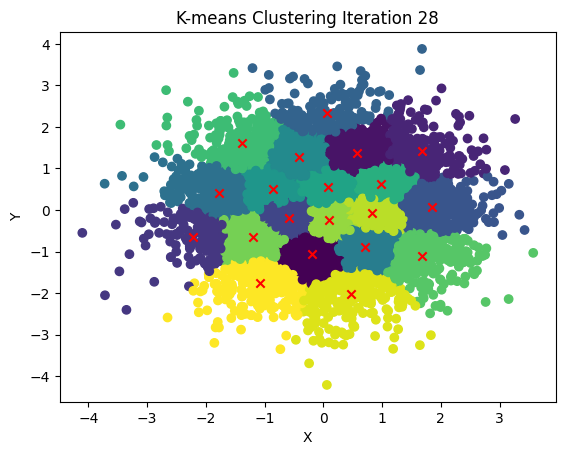

Iter: 29
Iteration 29: Variance = 0.9878641932783596


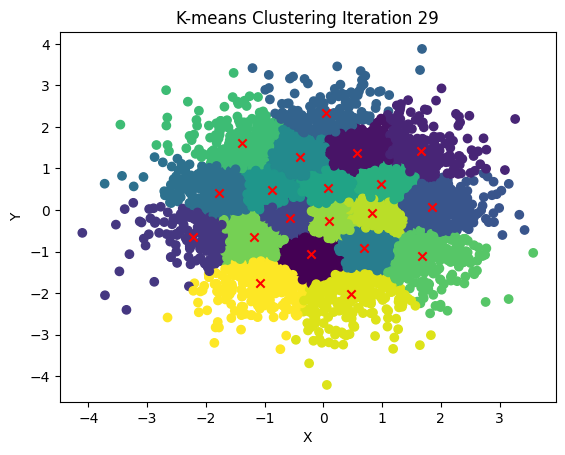

Iter: 30
Iteration 30: Variance = 0.9878641932783596


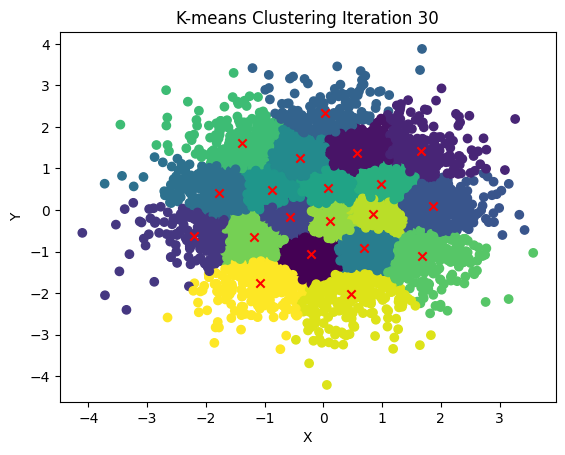

Iter: 31
Iteration 31: Variance = 0.9878641932783596


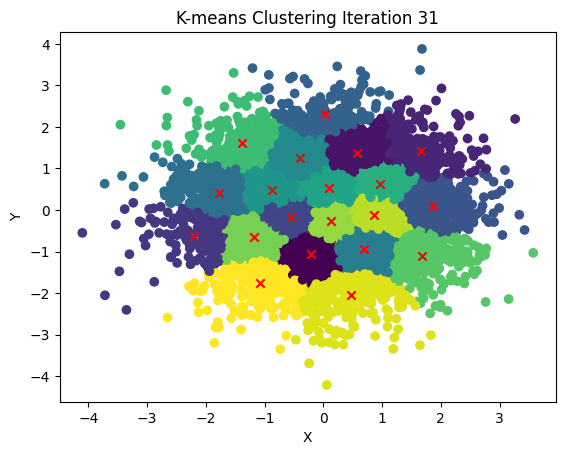

Iter: 32
Iteration 32: Variance = 0.9878641932783596


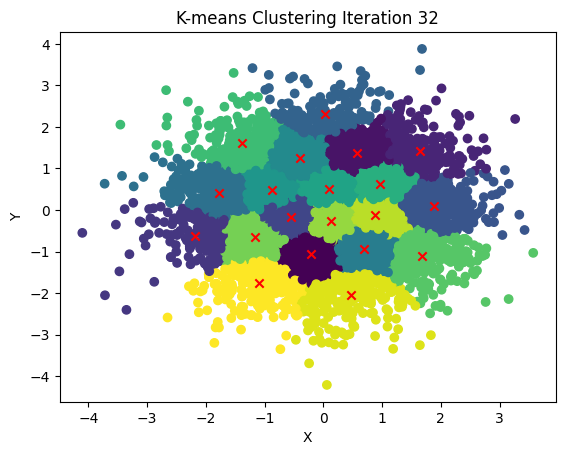

Iter: 33
Iteration 33: Variance = 0.9878641932783596


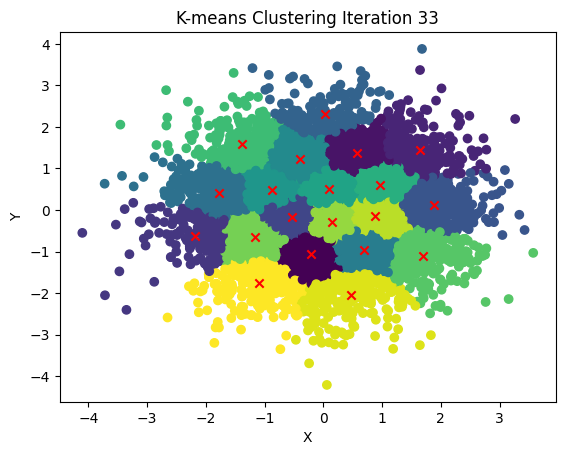

Iter: 34
Iteration 34: Variance = 0.9878641932783596


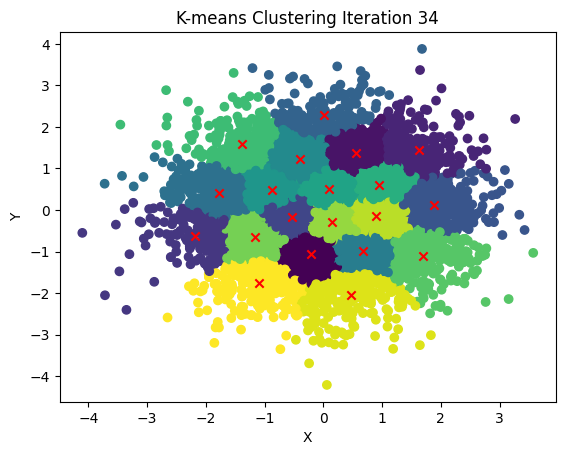

Iter: 35
Iteration 35: Variance = 0.9878641932783596


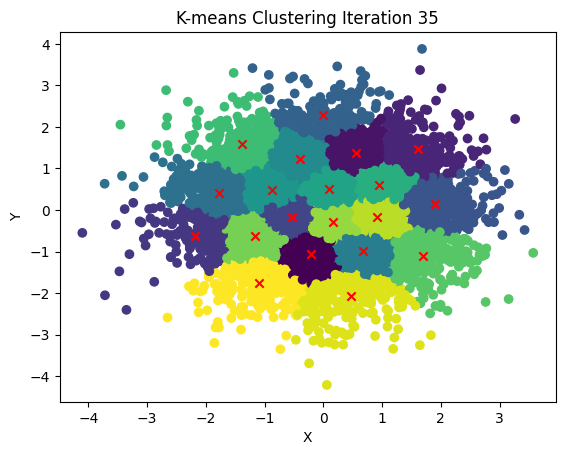

Iter: 36
Iteration 36: Variance = 0.9878641932783596


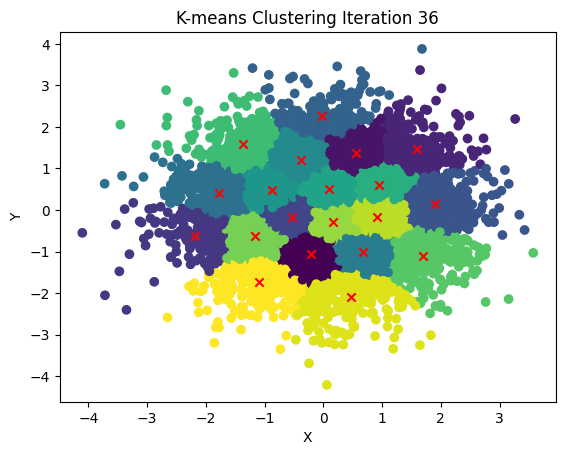

Iter: 37
Iteration 37: Variance = 0.9878641932783596


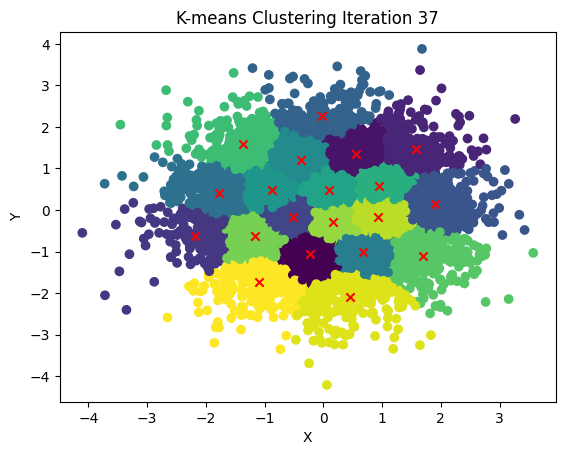

Iter: 38
Iteration 38: Variance = 0.9878641932783596


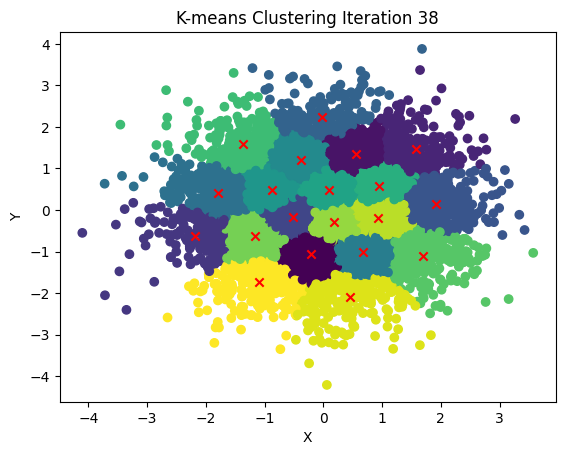

Iter: 39
Iteration 39: Variance = 0.9878641932783596


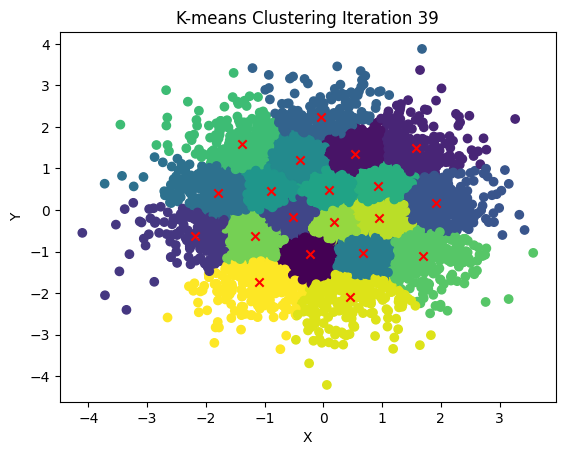

Iter: 40
Iteration 40: Variance = 0.9878641932783596


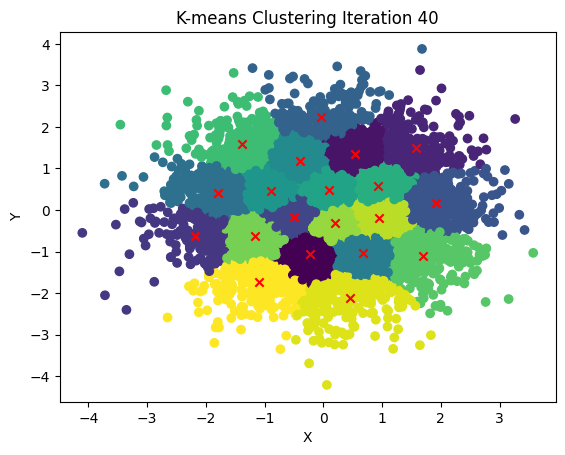

Iter: 41
Iteration 41: Variance = 0.9878641932783596


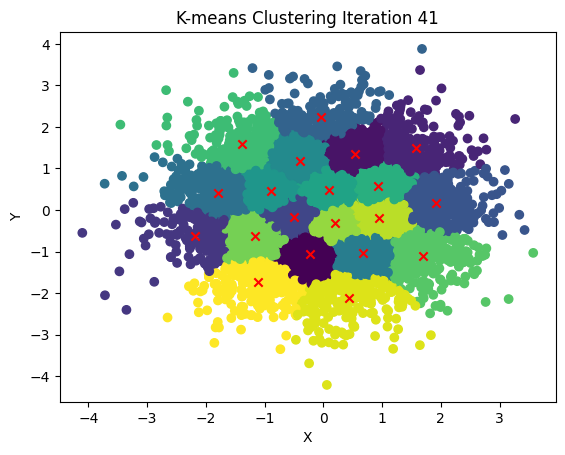

Iter: 42
Iteration 42: Variance = 0.9878641932783596


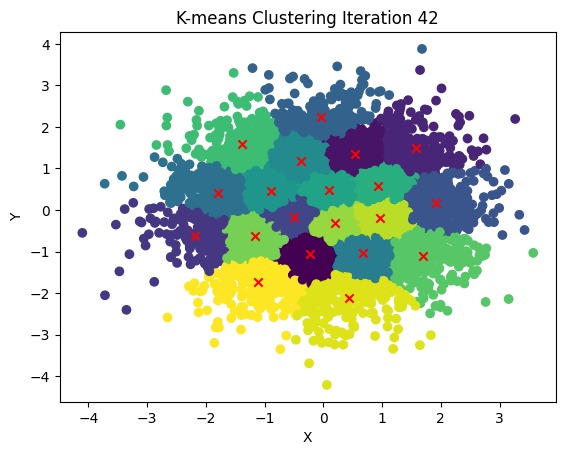

Iter: 43
Iteration 43: Variance = 0.9878641932783596


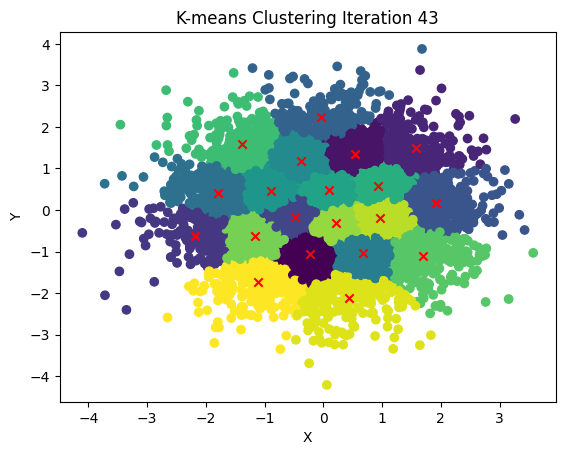

Iter: 44
Iteration 44: Variance = 0.9878641932783596


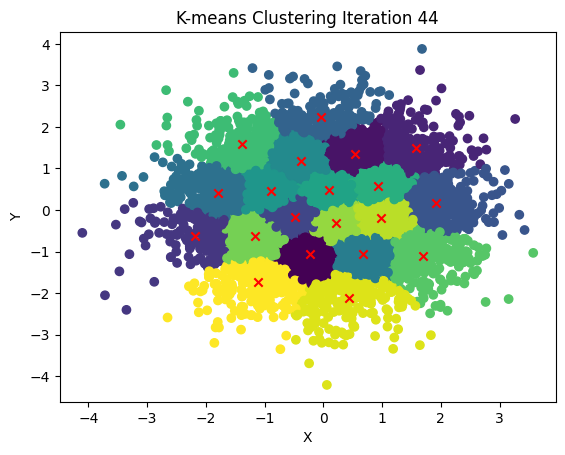

Iter: 45
Iteration 45: Variance = 0.9878641932783596


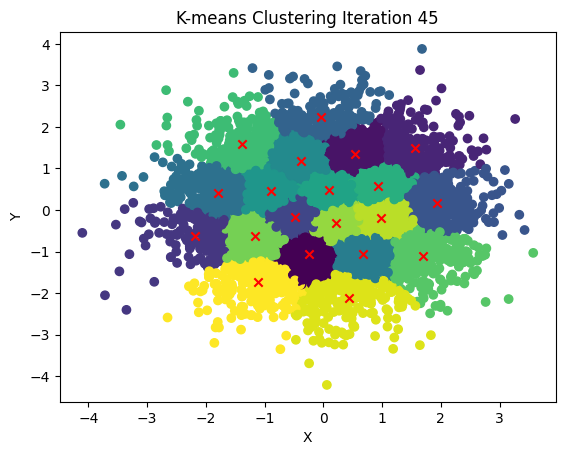

Iter: 46
Iteration 46: Variance = 0.9878641932783596


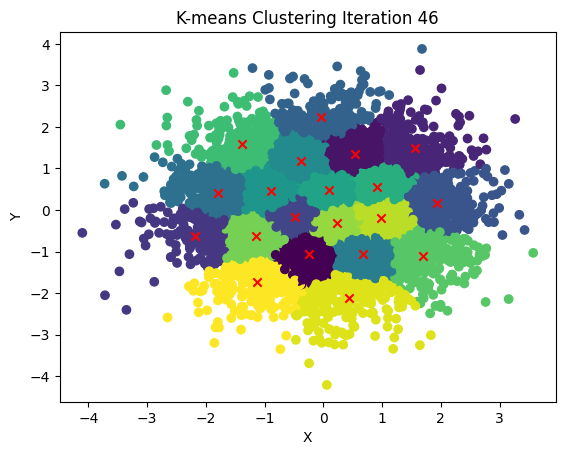

Iter: 47
Iteration 47: Variance = 0.9878641932783596


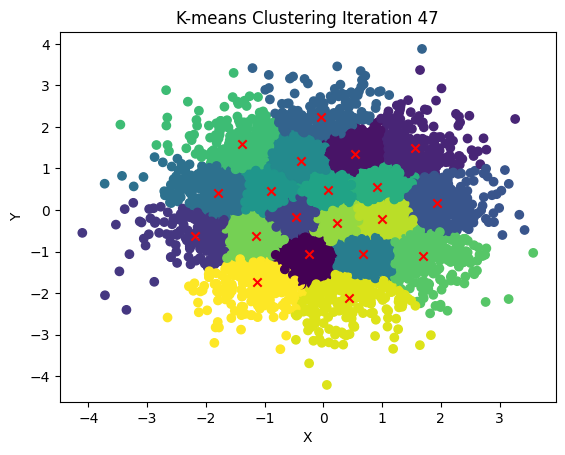

Iter: 48
Iteration 48: Variance = 0.9878641932783596


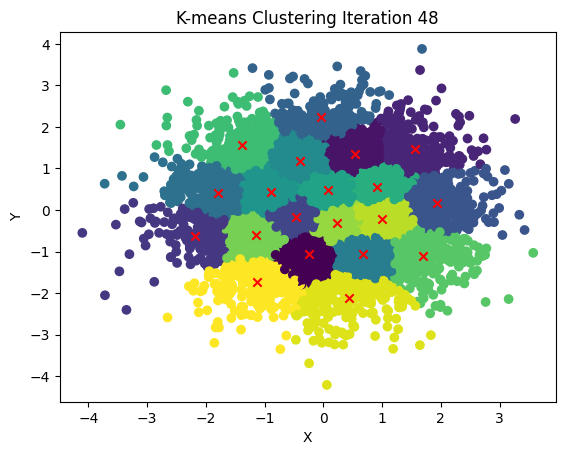

Iter: 49
Iteration 49: Variance = 0.9878641932783596


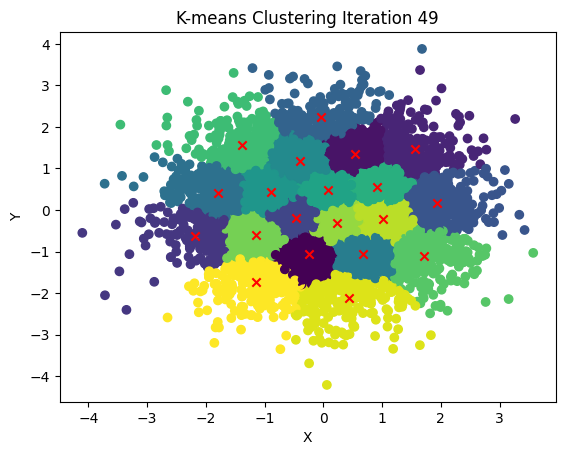

Iter: 50
Iteration 50: Variance = 0.9878641932783596


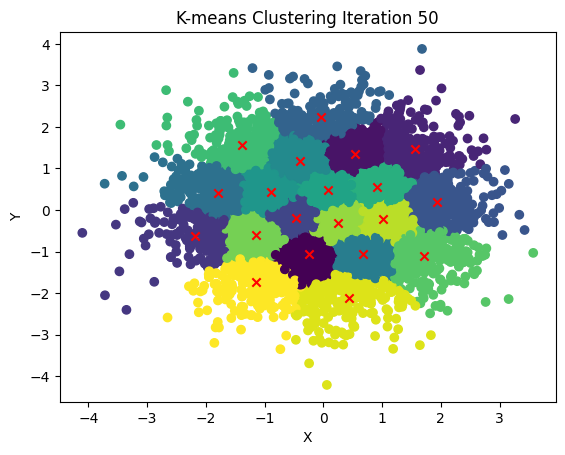

Iter: 51
Iteration 51: Variance = 0.9878641932783596


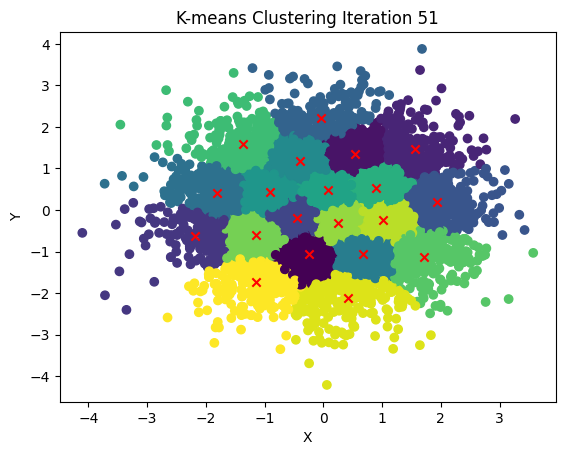

Iter: 52
Iteration 52: Variance = 0.9878641932783596


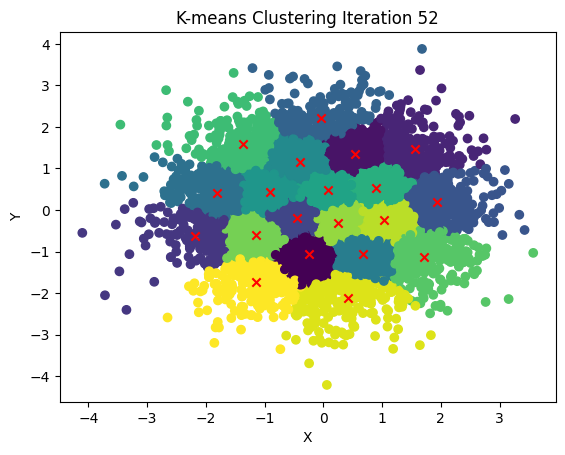

Iter: 53
Iteration 53: Variance = 0.9878641932783596


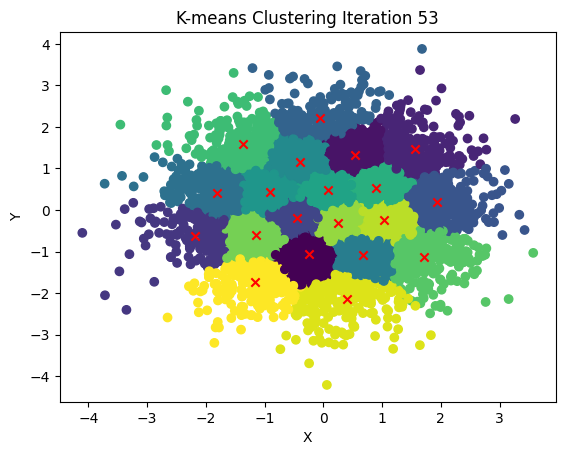

Iter: 54
Iteration 54: Variance = 0.9878641932783596


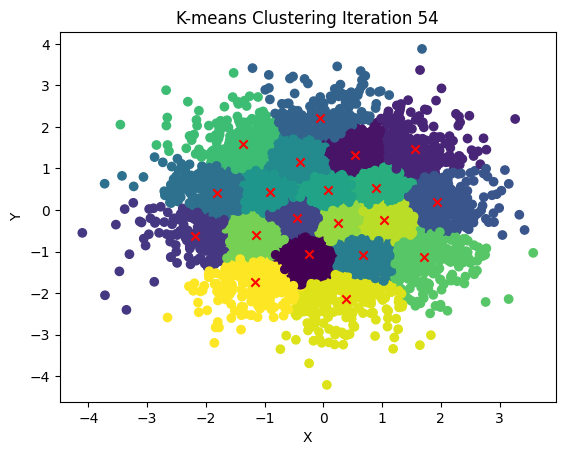

Iter: 55
Iteration 55: Variance = 0.9878641932783596


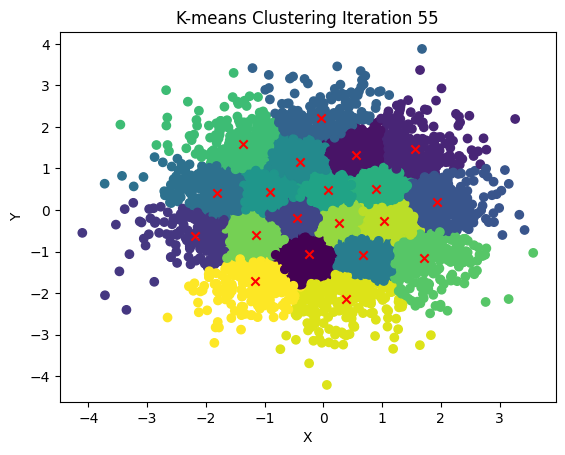

Iter: 56
Iteration 56: Variance = 0.9878641932783596


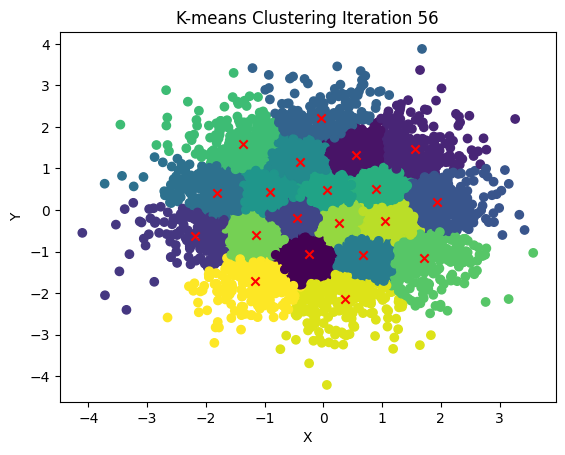

Iter: 57
Iteration 57: Variance = 0.9878641932783596


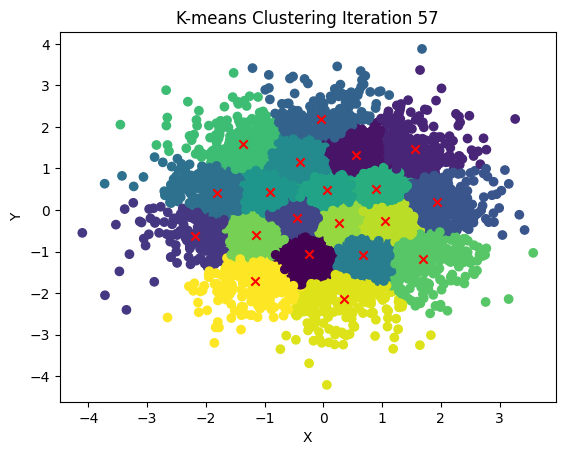

Iter: 58
Iteration 58: Variance = 0.9878641932783596


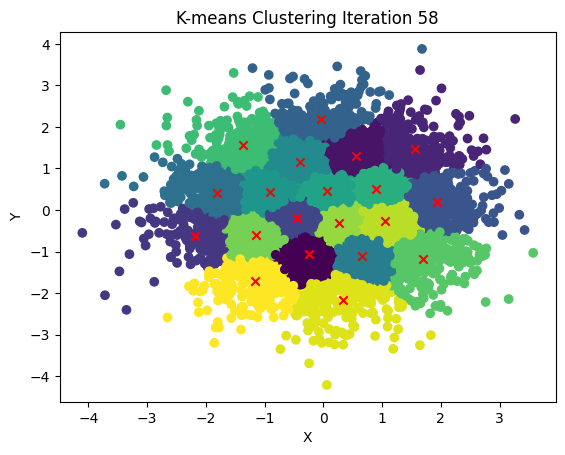

Iter: 59
Iteration 59: Variance = 0.9878641932783596


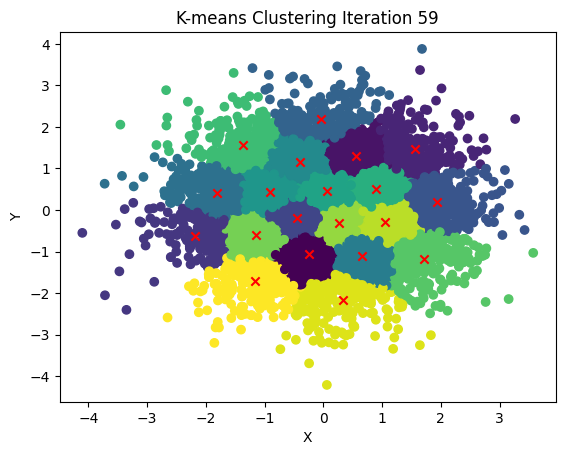

Iter: 60
Iteration 60: Variance = 0.9878641932783596


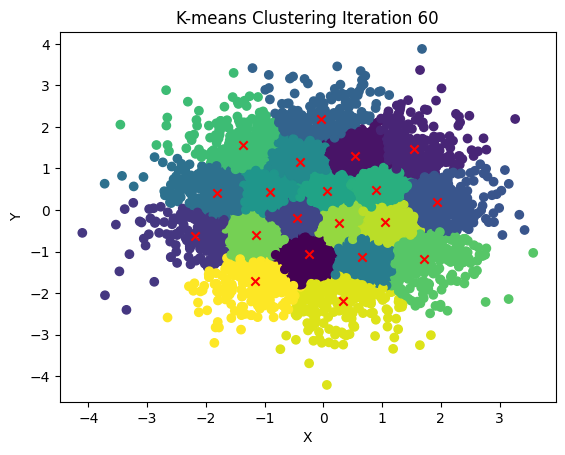

Iter: 61
Iteration 61: Variance = 0.9878641932783596


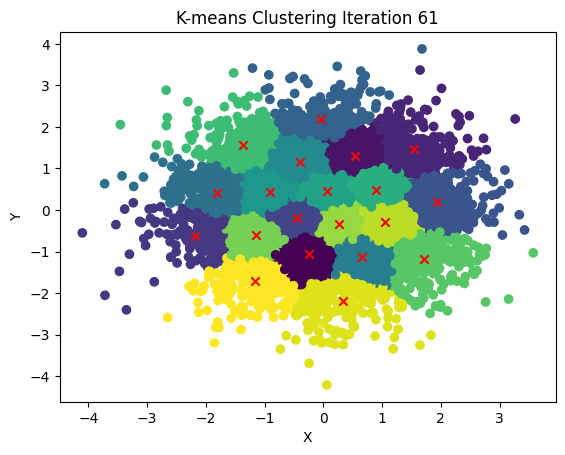

Iter: 62
Iteration 62: Variance = 0.9878641932783596


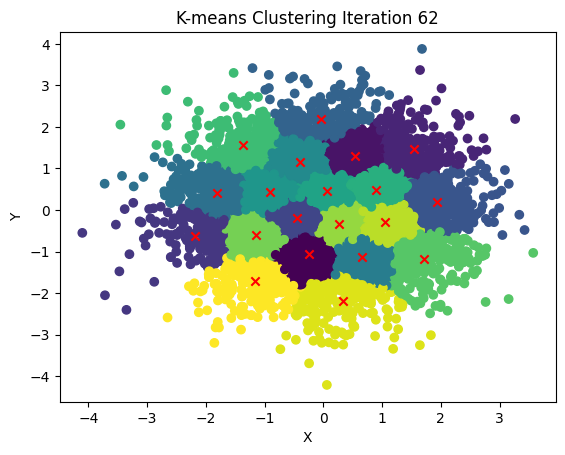

Iter: 63
Iteration 63: Variance = 0.9878641932783596


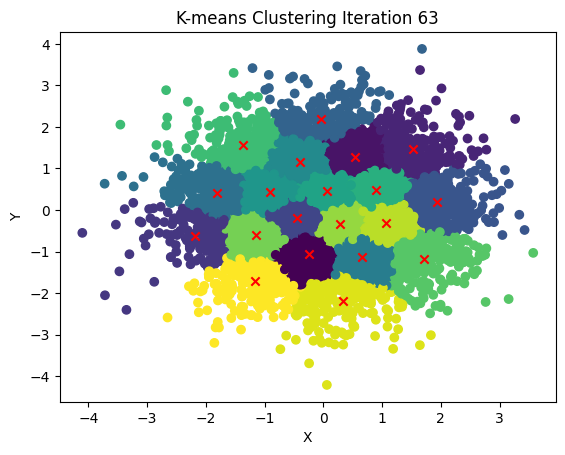

Iter: 64
Iteration 64: Variance = 0.9878641932783596


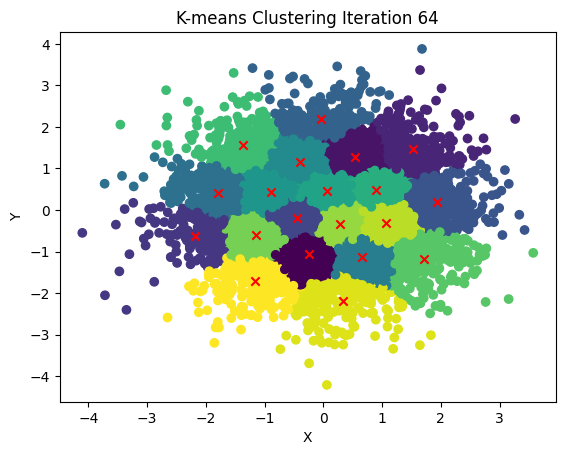

Iter: 65
Iteration 65: Variance = 0.9878641932783596


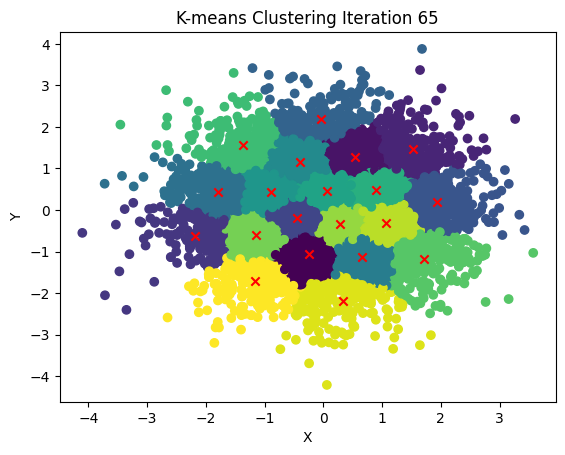

Iter: 66
Iteration 66: Variance = 0.9878641932783596


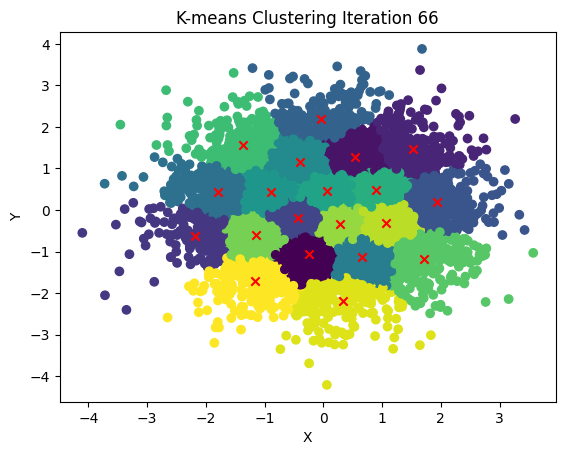

Iter: 67
Iteration 67: Variance = 0.9878641932783596


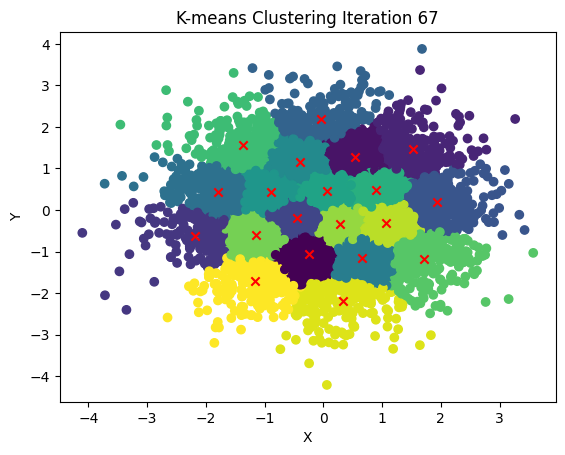

Iter: 68
Iteration 68: Variance = 0.9878641932783596


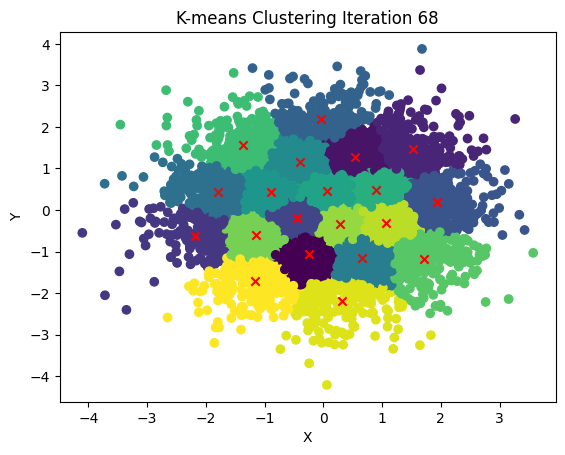

Iter: 69
Iteration 69: Variance = 0.9878641932783596


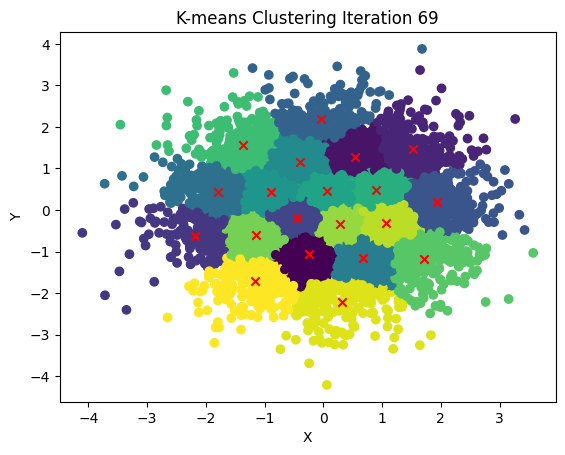

Iter: 70
Iteration 70: Variance = 0.9878641932783596


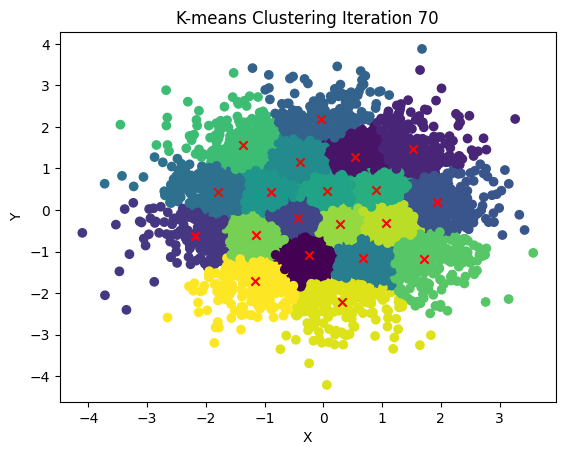

Iter: 71
Iteration 71: Variance = 0.9878641932783596


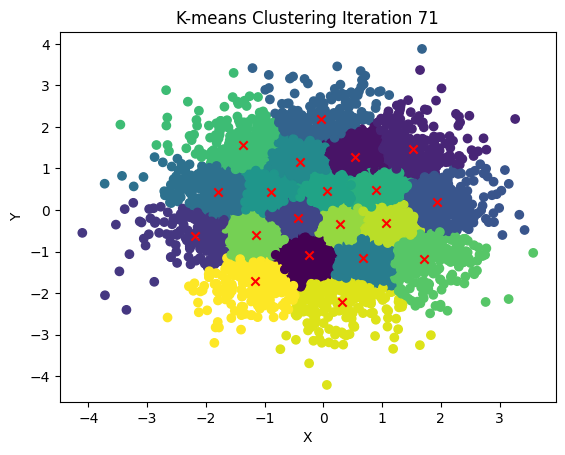

Iter: 72
Iteration 72: Variance = 0.9878641932783596


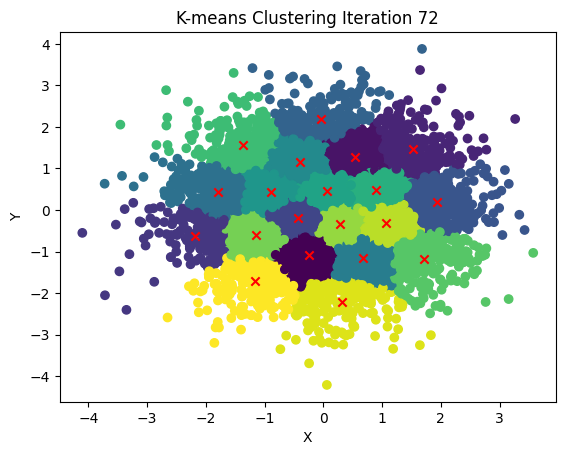

Iter: 73
Iteration 73: Variance = 0.9878641932783596


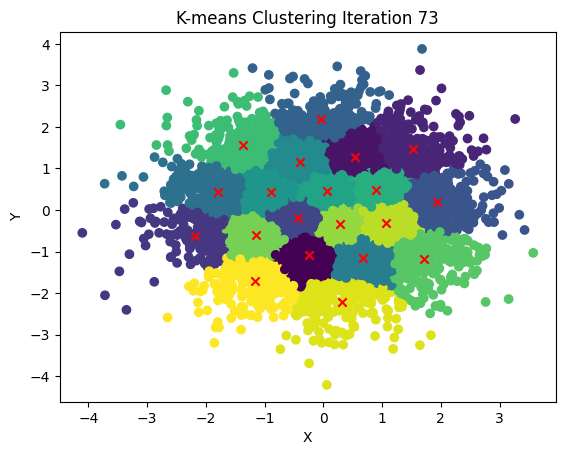

[[-0.2487047  -1.07679174]
 [ 0.54111318  1.28055273]
 [ 1.52395089  1.47101333]
 [-2.17874821 -0.62452104]
 [-0.43870727 -0.20410832]
 [ 1.93680086  0.1955969 ]
 [-0.03503661  2.18651834]
 [-1.79672499  0.42269962]
 [ 0.66737628 -1.15808245]
 [-0.38833715  1.15461898]
 [-0.89399636  0.42341881]
 [ 0.06379458  0.4481773 ]
 [ 0.89129112  0.47390809]
 [-1.36452059  1.57140678]
 [ 1.71826433 -1.17572502]
 [-1.14989952 -0.6009778 ]
 [ 0.27681774 -0.34042979]
 [ 1.06478446 -0.31277261]
 [ 0.32046279 -2.21092231]
 [-1.16512147 -1.71322171]] [ 4 15 11 ...  1 19  8]


In [49]:
from sklearn.mixture import GaussianMixture
import numpy as np

#GMM parameters
K = 4  
n_samples = 10000  

#data
data = np.random.randn(n_samples, 2)  

# Gaussian Mixture
gmm = GaussianMixture(n_components=K)

gmm.fit(data)

# Generate data from GMM
gen_data, _ = gmm.sample(n_samples)


print(gen_data)

num_clusters = 20  # Number of clusters
data_numpy=data

cen, labels = kmeans_cluster(data_numpy, num_clusters)
print(cen,labels)